# Backtest

In [1]:
!pip install pandas_ta
import pandas_ta as ta
!pip install backtesting
!pip install hyperopt

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.1/115.1 kB 3.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pandas_ta: filename=pandas_ta-0.3.14b0-py3-none-any.whl size=218909 sha256=9f1f462804311ed6133388dbc8a2e09f65e79ad05c1a18e8b86d5902def16085
  Stored in directory: /root/.cache/pip/wheels/69/00/ac/f7fa862c34b0e2ef320175100c233377b4c558944f12474cf0
Successfully built pandas_ta
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 175.5/175.5 kB 4.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for backtesting: filename=Backtesting-0.3.3-py3-none-any.whl size=173912 sha256=db034889a56135cb8f48c5f228314d268c5caefd9106f7ba285eb99465831965
  Stored in directory: /root/.cache/pip/wheels/e2/30/7f/19cbe31987c6ebdb47f1f510343249066711609e3da2d57176
Successfully built backtesting


In [2]:
!pip install pandas==1.5.3

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.1/12.1 MB 67.2 MB/s eta 0:00:00
  Attempting uninstall: pandas
    Found existing installation: pandas 2.2.2
    Uninstalling pandas-2.2.2:
      Successfully uninstalled pandas-2.2.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
cudf-cu12 24.10.1 requires pandas<2.2.3dev0,>=2.0, but you have pandas 1.5.3 which is incompatible.
google-colab 1.0.0 requires pandas==2.2.2, but you have pandas 1.5.3 which is incompatible.
mizani 0.11.4 requires pandas>=2.1.0, but you have pandas 1.5.3 which is incompatible.
plotnine 0.13.6 requires pandas<3.0.0,>=2.1.0, but you have pandas 1.5.3 which is incompatible.
xarray 2024.9.0 requires pandas>=2.1, but you have pandas 1.5.3 which is incompatible.


In [3]:
# УСТАНОВКА TA-LIB В COLAB
# Устанавливаем предварительно скомпилированные файлы библиотеки TA-Lib
!wget http://prdownloads.sourceforge.net/ta-lib/ta-lib-0.4.0-src.tar.gz
!tar -xzf ta-lib-0.4.0-src.tar.gz
%cd ta-lib
!./configure --prefix=/usr
!make
!make install
%cd ..
!pip install ta-lib

--2024-10-27 11:13:08--  http://prdownloads.sourceforge.net/ta-lib/ta-lib-0.4.0-src.tar.gz
Resolving prdownloads.sourceforge.net (prdownloads.sourceforge.net)... 204.68.111.105
Connecting to prdownloads.sourceforge.net (prdownloads.sourceforge.net)|204.68.111.105|:80... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: http://downloads.sourceforge.net/project/ta-lib/ta-lib/0.4.0/ta-lib-0.4.0-src.tar.gz [following]
--2024-10-27 11:13:09--  http://downloads.sourceforge.net/project/ta-lib/ta-lib/0.4.0/ta-lib-0.4.0-src.tar.gz
Resolving downloads.sourceforge.net (downloads.sourceforge.net)... 204.68.111.105
Reusing existing connection to prdownloads.sourceforge.net:80.
HTTP request sent, awaiting response... 302 Found
Location: http://cytranet-dal.dl.sourceforge.net/project/ta-lib/ta-lib/0.4.0/ta-lib-0.4.0-src.tar.gz?viasf=1 [following]
--2024-10-27 11:13:09--  http://cytranet-dal.dl.sourceforge.net/project/ta-lib/ta-lib/0.4.0/ta-lib-0.4.0-src.tar.gz?viasf=1

In [4]:
from datetime import datetime, timezone
from dateutil.relativedelta import relativedelta
import os
import requests
import zipfile
import csv
import io
import backtesting
from backtesting.lib import crossover

/usr/local/lib/python3.10/dist-packages/backtesting/_plotting.py:50: UserWarning: Jupyter Notebook detected. Setting Bokeh output to notebook. This may not work in Jupyter clients without JavaScript support (e.g. PyCharm, Spyder IDE). Reset with `backtesting.set_bokeh_output(notebook=False)`.
  warnings.warn('Jupyter Notebook detected. '


In [5]:
import pandas as pd

# Создаем пустой DataFrame с для хранения данных
columns = [
    'Symbol', 'Interval', 'Total Trades', 'Total PNL', 'Percentage PNL (%)',
    'Win Rate (%)', 'Profit Factor', 'Risk Ratio', 'Risk',
    'Num Long Trades', 'Num Short Trades', 'Num Profitable Trades', 'Num Unprofitable Trades',
    'Avg Profit', 'Avg Loss', 'Max Profit', 'Min Profit', 'Max Loss', 'Min Loss',
    'Avg Long Duration (days)', 'Avg Long Duration (hours)', 'Avg Long Duration (minutes)', 'Avg Long Duration (seconds)',
    'Avg Short Duration (days)', 'Avg Short Duration (hours)', 'Avg Short Duration (minutes)', 'Avg Short Duration (seconds)'
]


sloping_backtest_results = pd.DataFrame(columns=columns)

## Functions

### Get data and gnerate klines

In [6]:
def generate_months(start_date, end_date):
    """Генерирует список месяцев в заданном интервале."""
    start_date = datetime.strptime(start_date, '%Y-%m')
    end_date = datetime.strptime(end_date, '%Y-%m')
    months = []

    while start_date <= end_date:
        months.append(start_date.strftime('%Y-%m'))
        start_date = start_date + relativedelta(months=1)

    return months

def download_klines(symbol, interval, start_date, end_date):
    """Скачивает исторические данные свечей с Binance и возвращает DataFrame."""
    # Генерируем месяцы
    months = generate_months(start_date, end_date)

    # Создаем папки, если их нет
    if not os.path.exists('klines'):
        os.mkdir('klines')

    klines = {
        'Date': [],
        'Open': [],
        'High': [],
        'Low': [],
        'Close': [],
        'Volume': []
    }

    for month in months:
        filename = f"{symbol}-{interval}-{month}.zip"

        # Если нет klines, то скачиваем
        if not os.path.exists(f"klines/{filename}"):
            url = f"https://data.binance.vision/data/futures/um/monthly/klines/{symbol}/{interval}/{filename}"
            r = requests.get(url, allow_redirects=True)
            open(f"klines/{filename}", 'wb').write(r.content)

        # Открываем zip
        with zipfile.ZipFile(f"klines/{filename}", 'r') as zip_file:
            # Читаем csv внутри zip
            with zip_file.open(f"{symbol}-{interval}-{month}.csv", 'r') as csv_file:
                csv_reader = csv.reader(io.TextIOWrapper(csv_file, 'utf-8'))
                for row in csv_reader:
                    # Если строка содержит число (отбрасываем первую строку)
                    if row[0].isdigit():
                        # Заполняем списки с данными свечи
                        klines['Date'].append(datetime.fromtimestamp(int(row[0]) / 1000, tz=timezone.utc))
                        klines['Open'].append(float(row[1]))
                        klines['High'].append(float(row[2]))
                        klines['Low'].append(float(row[3]))
                        klines['Close'].append(float(row[4]))
                        klines['Volume'].append(float(row[5]))

    # Создаем DataFrame
    df = pd.DataFrame(klines)
    df['Date'] = pd.to_datetime(df['Date'])  # Конвертируем столбец 'Date' в datetime
    df.set_index('Date', inplace=True)

    return df

### Get_backtest_data

In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

initial_capital = 1_000_000

def get_backtest_data(trades, initial_capital=initial_capital):
    # Разделение сделок на лонг и шорт
    long_trades = trades[trades['Size'] > 0].copy()
    short_trades = trades[trades['Size'] < 0].copy()
    num_long_trades = len(long_trades)
    num_short_trades = len(short_trades)

    # Подсчет прибыльных и убыточных сделок
    profitable_trades = trades[trades['PnL'] > 0]
    unprofitable_trades = trades[trades['PnL'] <= 0]
    num_profitable_trades = len(profitable_trades)
    num_unprofitable_trades = len(unprofitable_trades)

    # Средняя прибыль и убыток
    avg_profit = profitable_trades['PnL'].mean() if num_profitable_trades > 0 else 0
    avg_loss = unprofitable_trades['PnL'].mean() if num_unprofitable_trades > 0 else 0

    # Средняя продолжительность сделок в лонг и шорт
    avg_long_duration = (long_trades['ExitTime'] - long_trades['EntryTime']).mean() if num_long_trades > 0 else pd.Timedelta(0)
    avg_short_duration = (short_trades['ExitTime'] - short_trades['EntryTime']).mean() if num_short_trades > 0 else pd.Timedelta(0)

    # Общая прибыль/убыток и процентное изменение от начального капитала
    total_profit = trades['PnL'].sum()
    percentage_profit_loss = (total_profit / initial_capital) * 100

    # Соотношение риска и интерпретация
    risk_ratio = abs(avg_loss / avg_profit) if avg_profit != 0 else float('inf')
    risk_interpretation = "Умеренные риски" if risk_ratio < 1 else ("Сбалансированные риски" if risk_ratio == 1 else "Высокие риски")

    # Метрики продолжительности сделок
    avg_long_days, avg_long_hours, avg_long_minutes, avg_long_seconds = avg_long_duration.components[:4]
    avg_short_days, avg_short_hours, avg_short_minutes, avg_short_seconds = avg_short_duration.components[:4]

    # Дополнительные метрики
    max_profit = profitable_trades['PnL'].max() if num_profitable_trades > 0 else 0
    min_profit = profitable_trades['PnL'].min() if num_profitable_trades > 0 else 0
    max_loss = unprofitable_trades['PnL'].min() if num_unprofitable_trades > 0 else 0
    min_loss = unprofitable_trades['PnL'].max() if num_unprofitable_trades > 0 else 0
    win_rate = (num_profitable_trades / len(trades)) * 100 if len(trades) > 0 else 0
    profit_factor = profitable_trades['PnL'].sum() / abs(unprofitable_trades['PnL'].sum()) if num_unprofitable_trades > 0 else float('inf')

    # Вывод всех результатов
    print("Результаты backtest:")
    print(f"Total Trades: {len(trades)}")
    print(f"Total PNL: {total_profit}")
    print(f"Percentage PNL (%): {percentage_profit_loss:.2f}")
    print(f"Win Rate (%): {win_rate:.2f}")
    print(f"Profit Factor: {profit_factor:.2f}")
    print(f"Risk Ratio: {risk_ratio:.2f}")
    print(f"Risk Interpretation: {risk_interpretation}")
    print(f"Num Long Trades: {num_long_trades}")
    print(f"Num Short Trades: {num_short_trades}")
    print(f"Num Profitable Trades: {num_profitable_trades}")
    print(f"Num Unprofitable Trades: {num_unprofitable_trades}")
    print(f"Avg Profit: {avg_profit:.2f}")
    print(f"Avg Loss: {avg_loss:.2f}")
    print(f"Max Profit: {max_profit}")
    print(f"Min Profit: {min_profit}")
    print(f"Max Loss: {max_loss}")
    print(f"Min Loss: {min_loss}")
    print(f"Avg Long Duration {avg_long_days} days, {avg_long_hours} hours, {avg_long_minutes} minutes, {avg_long_seconds} seconds")
    print(f"Avg Short Duration {avg_short_days} days, {avg_short_hours} hours, {avg_short_minutes} minutes, {avg_short_seconds} seconds")

    # Возвращение результатов в виде словаря
    return {
        'Total Trades': len(trades),
        'Total PNL': total_profit,
        'Percentage PNL (%)': percentage_profit_loss,
        'Win Rate (%)': win_rate,
        'Profit Factor': profit_factor,
        'Risk Ratio': risk_ratio,
        'Risk Interpretation': risk_interpretation,
        'Num Long Trades': num_long_trades,
        'Num Short Trades': num_short_trades,
        'Num Profitable Trades': num_profitable_trades,
        'Num Unprofitable Trades': num_unprofitable_trades,
        'Avg Profit': avg_profit,
        'Avg Loss': avg_loss,
        'Max Profit': max_profit,
        'Min Profit': min_profit,
        'Max Loss': max_loss,
        'Min Loss': min_loss,
        'Avg Long Duration (days)': avg_long_days,
        'Avg Long Duration (hours)': avg_long_hours,
        'Avg Long Duration (minutes)': avg_long_minutes,
        'Avg Long Duration (seconds)': avg_long_seconds,
        'Avg Short Duration (days)': avg_short_days,
        'Avg Short Duration (hours)': avg_short_hours,
        'Avg Short Duration (minutes)': avg_short_minutes,
        'Avg Short Duration (seconds)': avg_short_seconds
    }


# Пример вызова функции
# res должен быть объектом с данными о сделках
# Пример:
# result_table = analyze_trades(res, initial_capital=1_000_000, symbol='BTCUSDT', interval='1h')
# print(result_table)


### Plot Deposit and Price Changes

In [8]:
import plotly.graph_objs as go
from plotly.subplots import make_subplots


initial_capital = 1_000_000

def plot_deposit_and_price_change(trades, df, symbol, interval, initial_capital=initial_capital):
    # Calculate deposit changes
    deposit_changes = [initial_capital]
    for trade in trades.itertuples():
        deposit_changes.append(deposit_changes[-1] + trade.PnL)

    # Define time boundaries
    start_date = min(df.index.min(), trades['EntryTime'].min())
    end_date = max(df.index.max(), trades['ExitTime'].max())

    # Create subplots
    fig = make_subplots(rows=2, cols=1, shared_xaxes=True, vertical_spacing=0.1,
                        subplot_titles=f"Изменение депозита, {symbol}")

    # Deposit change plot
    fig.add_trace(go.Scatter(
        x=trades['ExitTime'],
        y=deposit_changes[1:],  # Skip initial capital for plotting
        mode='lines+markers',
        name='Изменение депозита',
        line=dict(color='blue'),
        hovertemplate='%{x}: Депозит: %{y:.2f}<br>Профит/Убыток: %{text}',
        text=[f'Профит: {trade.PnL:.2f}' if trade.PnL > 0 else f'Убыток: {trade.PnL:.2f}' for trade in trades.itertuples()]
    ), row=1, col=1)

    # BTC price plot
    fig.add_trace(go.Scatter(
        x=df.index,
        y=df['Close'],
        mode='lines',
        name='Цена BTC',
        line=dict(color='orange'),
        hovertemplate='Дата: %{x}<br>Цена: %{y:.2f}'
    ), row=2, col=1)

    # Add trades and arrows
    for trade in trades.itertuples():
        # Marker for deposit change plot (using ExitTime)
        marker_color = 'green' if trade.PnL > 0 else 'red'
        fig.add_trace(go.Scatter(
            x=[trade.ExitTime],
            y=[deposit_changes[trade.Index + 1]],
            mode='markers',
            marker=dict(color=marker_color, size=8, symbol='circle'),
            name='Профит' if trade.PnL > 0 else 'Убыток',
            hovertemplate=f'Сделка №{trade.Index + 1}: Профит: {trade.PnL:.2f}'
        ), row=1, col=1)

        # Arrow on the price plot (using EntryTime)
        arrow_symbol = '↑' if trade.Size > 0 else '↓'
        arrow_color = 'green' if trade.Size > 0 else 'red'
        fig.add_annotation(
            x=trade.EntryTime,
            y=df.loc[trade.EntryTime, 'Close'],
            text=arrow_symbol,
            showarrow=True,
            arrowhead=2,
            ax=0,
            ay=-30,
            font=dict(size=20, color=arrow_color),
            hovertext=f'Сделка №{trade.Index + 1} ({"Лонг" if trade.Size > 0 else "Шорт"})',
            hoverlabel=dict(bgcolor='white', bordercolor='black'),
            xref="x",
            yref="y2"  # Link to the second y-axis for the lower plot
        )

    # Layout settings
    fig.update_layout(
        title=f'Изменение депозита и цены {symbol} ({interval})',
        xaxis=dict(title='Дата', range=[start_date, end_date]),
        xaxis2=dict(title='Дата', range=[start_date, end_date]),
        yaxis=dict(title='Депозит ($)'),
        yaxis2=dict(title=f'Цена {symbol} ($)'),
        legend=dict(x=0, y=1),
        height=1200,
        width=5000
    )

    # X-axis display settings
    fig.update_xaxes(tickangle=-45)
    fig.update_layout(xaxis_rangeslider_visible=False)

    # Show plot
    fig.show()

# Example usage:
# plot_deposit_and_price_change(initial_capital, trades, df, 'BTC', '1h')


# Пример вызова функции
# plot_deposit_and_price_changes(trades, df, symbol, interval)


## Strategy

### Main

In [9]:
# Сама стратегия

from collections import deque
import numpy as np
from dataclasses import dataclass
import talib

# датакласс для сигналов
@dataclass
class Signal:
    side: bool
    price: float
    atr: float
    line: tuple

# класс для поиска наклонок
class Sloping:
    length: int
    ts: deque
    open: deque
    high: deque
    low: deque
    close: deque
    body_up: deque
    body_down: deque

    def __init__(self, length, atr_length=14, min_space=5, max_len=500, debug=False):
        # инициализируем переменные
        self.length = length
        self.atr_length = atr_length
        self.min_space = min_space
        self.max_len = max_len
        self.debug = debug
        # счетчики сигналов
        self._last_signal_resistance = min_space + 1
        self._last_signal_support = min_space + 1
        # создаем очереди
        for key, value in self.__annotations__.items():
            if issubclass(value, deque):
                setattr(self, key, deque([.0], maxlen=self.max_len))

    # функция для добавления свечи
    def add_kline(self, ts, open, high, low, close):
        ts = int(ts)
        # проверяем не дублируется ли свеча
        if not self.ts or ts > self.ts[-1]:
            # заполняем очереди
            self.ts.append(ts)
            self.open.append(float(open))
            self.high.append(float(high))
            self.low.append(float(low))
            self.close.append(float(close))
            # определяем верх и низ тела свечи
            self.body_up.append(max(float(open), float(close)))
            self.body_down.append(min(float(open), float(close)))
            # возвращаем True если добавили свечу
            return True
        return False

    # функция для получения сигнала
    def get_value(self, support=True, resistance=True):
        # если не хватает количества свеч, то пропускаем этот сигнал
        if len(self.ts) < self.length + 1:
            return None
        for is_resistance, side in enumerate([support, resistance]):
            # если нам не нужно вычислять поддержу или сопротивление, то пропускаем
            if not side:
                continue
            # берем окно для поиска наклонки (необходимую нам часть тела свечи)
            window = np.array(list(self.body_up if is_resistance else self.body_down)[-self.length:])
            # генерируем индексы свечей
            x = np.arange(len(window))
            # вычисляем точки для поиска наклонки
            slope, intercept = np.polyfit(x, window, 1)
            points = slope * x + intercept
            # ищем минимум или максимум в пределах окна, в зависимости от того, что мы ищем
            value = (window - points).argmax() if is_resistance else (window - points).argmin()
            # получаем наклонную линию
            line = self._get_line(window, slope, value, is_resistance)
            # если произошел пробой сопротивления
            if is_resistance and (self.close[-1] > line[1] + self.length * line[0] or self.debug):
                # если сигнал был более min_space количества свечей назад
                if self._last_signal_resistance > self.min_space:
                    # обнуляем счетчик
                    self._last_signal_resistance = 0
                    # возвращаем сигнал
                    return Signal(True, self.close[-1], self.get_atr(), line)
                # обнуляем счетчик в любом случае
                self._last_signal_resistance = 0
            else:
                # если не было сигнала, то увеличиваем счетчик
                self._last_signal_resistance += 1
            # если произошел пробой поддержки
            if not is_resistance and (self.close[-1] < line[1] + self.length * line[0] or self.debug):
                # если сигнал был более min_space количества свечей назад
                if self._last_signal_support > self.min_space:
                    # обнуляем счетчик
                    self._last_signal_support = 0
                    # возвращаем сигнал
                    return Signal(False, self.close[-1], self.get_atr(), line)
                # обнуляем счетчик в любом случае
                self._last_signal_support = 0
            else:
                # если не было сигнала, то увеличиваем счетчик
                self._last_signal_support += 1

    # функция для поиска наклонной линии
    def _get_line(self, window, slope, value_index, is_resistance):
        # вычисляем шаг изменения наклона
        slope_step = (window.max() - window.min()) / len(window)
        # инициализируем начальные значения
        step = 1
        min_step = 0.0001
        best_slope = slope
        # вычисляем первоначальное значение тренда
        best_value = self._check_trend(window, slope, value_index, is_resistance)
        # флаг для вычисления производной
        get_der = True
        # переменная для хранения производной
        der = None
        # пока шаг не меньше min_step
        while step > min_step:
            # если нам нужно вычислять производную
            if get_der:
                # изменяем наклон на минимальный шаг
                slope_change = best_slope + slope_step * min_step
                # вычисляем значение еще раз
                test_value = self._check_trend(window, slope_change, value_index, is_resistance)
                # если значение меньше нуля, то меняем наклон
                if test_value < 0:
                    slope_change = best_slope - slope_step * min_step
                    # вычисляем значение еще раз
                    test_value = self._check_trend(window, slope_change, value_index, is_resistance)
                # запоминаем производную
                der = test_value - best_value
                get_der = False
            # в зависимости от знака производной меняем наклон
            if der > 0:
                test_slope = best_slope - slope_step * step
            else:
                test_slope = best_slope + slope_step * step
            # вычисляем значение
            test_value = self._check_trend(window, test_slope, value_index, is_resistance)
            # если значение меньше нуля или не улучшает лучшее значение, то уменьшаем шаг в 2 раза
            if test_value < 0 or test_value >= best_value:
                step *= 0.5
            else:
                # если значение улучшилось, то запоминаем наклон и значение
                best_slope = test_slope
                best_value = test_value
                get_der = True
        # возвращаем лучшее значение и пересечение с линей
        return best_slope, -best_slope * value_index + window[value_index]

    # функция для проверки тренда
    def _check_trend(self, window, slope, value_index, is_resistance):
        # вычисляем пересечение с линей
        intecept = -slope * value_index + window[value_index]
        # получаем все точки наклонки
        line_vals = slope * np.arange(len(window)) + intecept
        # вычисляем разницу между точками наклонки и телом свечей
        diffs = line_vals - window
        # проверяем линию на корректность
        if (not is_resistance and diffs.max() > 0) or (is_resistance and diffs.min() < 0):
            # если линия некорректна, то возвращаем -1
            return -1
        # возвращаем сумму квадратов разниц, которая является мерой отклонения линии тренда
        return (diffs ** 2).sum()

    # функция для получения ATR
    def get_atr(self):
        # вычисляем ATR
        return talib.ATR(np.array(self.high), np.array(self.low), np.array(self.close), self.atr_length)[-1]

        # # вычисляем ATR с использованием pandas_ta
        # atr = ta.atr(self.high, self.low, self.close, length=self.atr_length)[-1]
        # return atr.iloc[-1]  # возвращаем последнее значение ATR

### Base Backtest

In [10]:
class SlopingStrategyBasic(backtesting.Strategy):

  # Лучшие параметры: {'length': 66.0, 'min_space': 15.0} # получается лучше, чем просто холдить, но долгое нахождение в сделках
    window_length = 66  # оптимальные параметры для sloping length
    min_space = 15

    def init(self):
        self.slope_indicator = Sloping(length=self.window_length, min_space=self.min_space)

    def next(self):
        # Добавляем текущие данные свечей в индикатор
        self.slope_indicator.add_kline(self.data.index[-1].timestamp(),
                                       self.data.Open[-1],
                                       self.data.High[-1],
                                       self.data.Low[-1],
                                       self.data.Close[-1])

        # Получаем сигнал от индикатора
        signal = self.slope_indicator.get_value()


        # Если сигнал на покупку и нет позиции
        if signal and signal.side and not self.position:
            self.buy()

        # Если сигнал на продажу и нет позиции
        elif signal and not signal.side and not self.position:
            self.sell()

        # Если сигнал на продажу, а позиция лонг
        elif signal and not signal.side and self.position.is_long:
            self.position.close()

        # Если сигнал на покупку, а позиция шорт
        elif signal and signal.side and self.position.is_short:
            self.position.close()


# df['Date'] = pd.to_datetime(df['Date'])  # Ensure 'Date' column is datetime
# df.set_index('Date', inplace=True)      # Set 'Date' as index

### Base+Take+Loss Backtest

## BTC testing

### 4h timeframe

In [ ]:
# основные параметры
symbol = 'BTCUSDT'
interval = '4h'
start_date = '2020-01'
end_date = '2024-09'


df = download_klines(symbol, interval, start_date, end_date)
print(df)

                               Open      High       Low     Close     Volume
Date                                                                        
2020-01-01 00:00:00+00:00   7189.43   7239.74   7170.15   7221.65  12055.759
2020-01-01 04:00:00+00:00   7221.80   7230.00   7193.52   7205.26   5738.351
2020-01-01 08:00:00+00:00   7205.26   7234.57   7174.00   7192.65  10036.293
2020-01-01 12:00:00+00:00   7192.74   7260.43   7191.79   7229.49  11010.528
2020-01-01 16:00:00+00:00   7229.66   7248.00   7210.81   7226.35   7787.862
...                             ...       ...       ...       ...        ...
2024-09-30 04:00:00+00:00  64539.90  64686.00  64300.00  64539.10  24981.714
2024-09-30 08:00:00+00:00  64539.00  64552.90  63222.00  63794.40  76458.979
2024-09-30 12:00:00+00:00  63794.40  64130.80  63490.20  63535.60  48875.810
2024-09-30 16:00:00+00:00  63535.70  63722.40  63036.20  63472.80  45469.704
2024-09-30 20:00:00+00:00  63472.90  63845.00  62825.00  63309.10  31180.332

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 10410 entries, 2020-01-01 00:00:00+00:00 to 2024-09-30 20:00:00+00:00
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Open    10410 non-null  float64
 1   High    10410 non-null  float64
 2   Low     10410 non-null  float64
 3   Close   10410 non-null  float64
 4   Volume  10410 non-null  float64
dtypes: float64(5)
memory usage: 488.0 KB


#### Base

In [ ]:
# запускаем бэктест и выводим результат
test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=.0005)
res = test.run()
print(res)

Start                     2020-01-01 00:00...
End                       2024-09-30 20:00...
Duration                   1734 days 20:00:00
Exposure Time [%]                   65.264169
Equity Final [$]                598917.289955
Equity Peak [$]                1509801.414755
Return [%]                         -40.108271
Buy & Hold Return [%]              776.656997
Return (Ann.) [%]                  -10.223301
Volatility (Ann.) [%]               69.122777
Sharpe Ratio                              0.0
Sortino Ratio                             0.0
Calmar Ratio                              0.0
Max. Drawdown [%]                  -84.363535
Avg. Drawdown [%]                  -11.638403
Max. Drawdown Duration     1659 days 12:00:00
Avg. Drawdown Duration      172 days 03:00:00
# Trades                                   98
Win Rate [%]                        56.122449
Best Trade [%]                      38.617321
Worst Trade [%]                     -70.94037
Avg. Trade [%]                    

In [ ]:
# trades = res._trades
# trades



---


Подбор параметров

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    window_length = int(params['window_length'])
    min_space = int(params['min_space'])


    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategyBasic,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(window_length=window_length,
                   min_space=min_space)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    'window_length': hp.quniform('window_length', 10, 100, 1),
    'min_space': hp.quniform('min_space', 5, 20, 1)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=10, trials=trials)

print("Лучшие параметры:", best)

100%|██████████| 10/10 [01:59<00:00, 11.91s/trial, best loss: -67.43646760400043]
Лучшие параметры: {'min_space': 8.0, 'window_length': 77.0}


In [ ]:
# Continue the search with 10 more iterations (total of 25 now)
best = fmin(objective, space, algo=tpe.suggest, max_evals=20, trials=trials)
print("Лучшие параметры:", best)

100%|██████████| 20/20 [02:01<00:00, 12.16s/trial, best loss: -67.43646760400043]
Лучшие параметры: {'min_space': 8.0, 'window_length': 77.0}


In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест
basis = 'BASIC'
optimized_length = int(best['window_length'])
optimized_min_space = int(best['min_space'])

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

Результаты с оптимизированными параметрами: Start                     2020-01-01 00:00...
End                       2024-09-30 20:00...
Duration                   1734 days 20:00:00
Exposure Time [%]                   72.228626
Equity Final [$]                 750950.45189
Equity Peak [$]                 1739786.35209
Return [%]                         -24.904955
Buy & Hold Return [%]              776.656997
Return (Ann.) [%]                   -5.847519
Volatility (Ann.) [%]               91.055002
Sharpe Ratio                              0.0
Sortino Ratio                             0.0
Calmar Ratio                              0.0
Max. Drawdown [%]                  -92.747218
Avg. Drawdown [%]                  -10.968592
Max. Drawdown Duration     1449 days 08:00:00
Avg. Drawdown Duration       95 days 14:00:00
# Trades                                  110
Win Rate [%]                        51.818182
Best Trade [%]                      38.617321
Worst Trade [%]                    -

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

Результаты backtest:
Total Trades: 110
Total PNL: -249049.54810999508
Percentage PNL (%): -24.90
Win Rate (%): 51.82
Profit Factor: 0.94
Risk Ratio: 1.14
Risk Interpretation: Высокие риски
Num Long Trades: 53
Num Short Trades: 57
Num Profitable Trades: 57
Num Unprofitable Trades: 53
Avg Profit: 67670.26
Avg Loss: -77476.50
Max Profit: 392038.4720000002
Min Profit: 1013.0785499999656
Max Loss: -1205564.17575
Min Loss: -486.2612000000736
Avg Long Duration (days): 9, (hours): 19, (minutes): 1, (seconds): 7
Avg Short Duration (days): 12, (hours): 13, (minutes): 24, (seconds): 12


In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval
backtest_result.update(best)

backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

<ipython-input-20-7bc495179423>:7: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
/usr/local/lib/python3.10/dist-packages/google/colab/_interactive_table_hint_button.py:178: FutureWarning: Index.format is deprecated and will be removed in a future version. Convert using index.astype(str) or index.map(formatter) instead.
  df_html=dataframe._repr_html_(),  # pylint: disable=protected-access
/usr/local/lib/python3.10/dist-packages/google/colab/_interactive_table_hint_button.py:178: FutureWarning: RangeIndex.format is deprecated and will be removed in a future version. Convert using index.astype(str) or index.map(formatter) instead.
  df_html

,Symbol,Interval,Total Trades,Total PNL,Percentage PNL (%),Win Rate (%),Profit Factor,Risk Ratio,Risk,Num Long Trades,...,Avg Long Duration (hours),Avg Long Duration (minutes),Avg Long Duration (seconds),Avg Short Duration (days),Avg Short Duration (hours),Avg Short Duration (minutes),Avg Short Duration (seconds),Risk Interpretation,min_space,window_length
0,BTCUSDT,4h,110,-249049.54811,-24.904955,51.818182,0.939349,1.144912,NaN,53,...,19,1,7,12,13,24,12,Высокие риски,8.0,77.0


In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

#### Base + Take & Loss

In [ ]:
import backtesting
import pandas as pd

basis = 'BASE+TAKELOSS'
# Класс стратегии для backtesting
class SlopingStrategy(backtesting.Strategy):

    # Параметры стратегии
    window_length = int(best.get('window_length', 50))
    min_space = int(best.get('min_space', 5))
    atr_length = 27  # Период для расчета ATR
    stop_loss_multiplier = 4.67  # Мультиплеер для стоп-лосса
    take_profit_multiplier = 4.98  # Мультиплеер для тейк-профита

    def init(self):
        self.slope_indicator = Sloping(length=self.window_length, min_space=self.min_space)
        self.atr = self.I(ta.atr, self.data.High.s, self.data.Low.s, self.data.Close.s, length=self.atr_length)

    def next(self):
        # Добавляем текущие данные свечей в индикатор
        self.slope_indicator.add_kline(self.data.index[-1].timestamp(),
                                       self.data.Open[-1],
                                       self.data.High[-1],
                                       self.data.Low[-1],
                                       self.data.Close[-1])

        # Получаем сигнал от индикатора
        signal = self.slope_indicator.get_value()

        # Текущее значение ATR для текущей свечи
        current_atr = self.atr[-1]

        # Если сигнал на покупку и нет позиции
        if signal and signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] - (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] + (self.take_profit_multiplier * current_atr)
            self.buy(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу и нет позиции
        elif signal and not signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] + (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] - (self.take_profit_multiplier * current_atr)
            self.sell(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу, а позиция лонг
        elif signal and not signal.side and self.position.is_long:
            self.position.close()

        # Если сигнал на покупку, а позиция шорт
        elif signal and signal.side and self.position.is_short:
            self.position.close()

# Загрузка данных
# df['Date'] = pd.to_datetime(df['Date'])  # Ensure 'Date' column is datetime
# df.set_index('Date', inplace=True)      # Set 'Date' as index


# Запускаем бэктест и выводим результат
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=.0005)
res = test.run()
print(res)


Start                     2020-01-01 00:00...
End                       2024-09-30 20:00...
Duration                   1734 days 20:00:00
Exposure Time [%]                   55.254563
Equity Final [$]                932099.339219
Equity Peak [$]                1171506.509252
Return [%]                          -6.790066
Buy & Hold Return [%]              776.656997
Return (Ann.) [%]                    -1.46838
Volatility (Ann.) [%]               46.121204
Sharpe Ratio                              0.0
Sortino Ratio                             0.0
Calmar Ratio                              0.0
Max. Drawdown [%]                  -62.696999
Avg. Drawdown [%]                   -8.742962
Max. Drawdown Duration     1648 days 20:00:00
Avg. Drawdown Duration      132 days 00:00:00
# Trades                                  138
Win Rate [%]                        49.275362
Best Trade [%]                      19.377776
Worst Trade [%]                    -18.024258
Avg. Trade [%]                    

In [ ]:
# res._trades

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    # window_length = int(best['window_length']) if best['window_length'] else 50
    # min_space = int(best['min_space']) if best['min_space'] else 5
    atr_length = int(params['atr_length'])
    take_profit_multiplier = params['take_profit_multiplier']
    stop_loss_multiplier = params['stop_loss_multiplier']

    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategy,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(#window_length=window_length,
                   #min_space=min_space,
                   atr_length=atr_length,
                   take_profit_multiplier=take_profit_multiplier,
                   stop_loss_multiplier=stop_loss_multiplier)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    #'window_length': hp.quniform('window_length', 5, 100, 1),
    #'min_space': hp.quniform('min_space', 1, 20, 1),
    'atr_length': hp.quniform('atr_length', 5, 30, 1),
    'take_profit_multiplier': hp.uniform('take_profit_multiplier', 1.0, 5.0),
    'stop_loss_multiplier': hp.uniform('stop_loss_multiplier', 1.0, 5.0)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=5, trials=trials)

print("Лучшие параметры:", best)

100%|██████████| 5/5 [01:01<00:00, 12.35s/trial, best loss: -75.62842593188668]
Лучшие параметры: {'atr_length': 18.0, 'stop_loss_multiplier': 1.8772276800730023, 'take_profit_multiplier': 3.2171347063146274}


In [ ]:
# Continue the search
best = fmin(objective, space, algo=tpe.suggest, max_evals=15, trials=trials)
print("Лучшие параметры:", best)

100%|██████████| 15/15 [01:58<00:00, 11.81s/trial, best loss: -75.62842593188668]
Лучшие параметры: {'atr_length': 18.0, 'stop_loss_multiplier': 1.8772276800730023, 'take_profit_multiplier': 3.2171347063146274}


In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест

SlopingStrategy.window_length = int(best.get('window_length', SlopingStrategy.window_length))
SlopingStrategy.min_space = int(best.get('min_space', SlopingStrategy.min_space))
SlopingStrategy.atr_length = int(best['atr_length'])
SlopingStrategy.stop_loss_multiplier = float(best['stop_loss_multiplier'])
SlopingStrategy.take_profit_multiplier = float(best['take_profit_multiplier'])

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

basis = 'BASIC_TAKELOSS'

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

Результаты с оптимизированными параметрами: Start                     2020-01-01 00:00...
End                       2024-09-30 20:00...
Duration                   1734 days 20:00:00
Exposure Time [%]                    36.73391
Equity Final [$]               1756284.259319
Equity Peak [$]                 1862949.07801
Return [%]                          75.628426
Buy & Hold Return [%]              776.656997
Return (Ann.) [%]                   12.578782
Volatility (Ann.) [%]               41.539114
Sharpe Ratio                         0.302818
Sortino Ratio                        0.534878
Calmar Ratio                         0.281765
Max. Drawdown [%]                  -44.642829
Avg. Drawdown [%]                   -5.282104
Max. Drawdown Duration     1039 days 04:00:00
Avg. Drawdown Duration       43 days 22:00:00
# Trades                                  237
Win Rate [%]                        45.147679
Best Trade [%]                       22.35998
Worst Trade [%]                    -

UsageError: Line magic function `%%capture` not found.


In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

Результаты backtest:
Total Trades: 237
Total PNL: 756284.2593188677
Percentage PNL (%): 75.63
Win Rate (%): 45.15
Profit Factor: 1.14
Risk Ratio: 0.72
Risk Interpretation: Умеренные риски
Num Long Trades: 111
Num Short Trades: 126
Num Profitable Trades: 107
Num Unprofitable Trades: 130
Avg Profit: 57531.31
Avg Loss: -41535.12
Max Profit: 221669.61069565665
Min Profit: 2699.1075000001456
Max Loss: -180015.98325250472
Min Loss: -6089.1016199999285
Avg Long Duration 2 days, 18 hours, 24 minutes, 51 seconds
Avg Short Duration 2 days, 7 hours, 21 minutes, 54 seconds


In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval


if 'window_length' not in best or not best['window_length']:
    best['window_length'] = SlopingStrategy.window_length


if 'min_space' not in best or not best['min_space']:
    best['min_space'] = SlopingStrategy.min_space

backtest_result.update(best)
backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

/usr/local/lib/python3.10/dist-packages/google/colab/_interactive_table_hint_button.py:178: FutureWarning:

Index.format is deprecated and will be removed in a future version. Convert using index.astype(str) or index.map(formatter) instead.

/usr/local/lib/python3.10/dist-packages/google/colab/_interactive_table_hint_button.py:178: FutureWarning:

RangeIndex.format is deprecated and will be removed in a future version. Convert using index.astype(str) or index.map(formatter) instead.



,Symbol,Interval,Total Trades,Total PNL,Percentage PNL (%),Win Rate (%),Profit Factor,Risk Ratio,Risk,Num Long Trades,...,Avg Short Duration (days),Avg Short Duration (hours),Avg Short Duration (minutes),Avg Short Duration (seconds),Risk Interpretation,min_space,window_length,atr_length,stop_loss_multiplier,take_profit_multiplier
0,BTCUSDT,4h,110,-249049.548110,-24.904955,51.818182,0.939349,1.144912,NaN,53,...,12,13,24,12,Высокие риски,8.0,77.0,NaN,NaN,NaN
1,BTCUSDT,4h,237,756284.259319,75.628426,45.147679,1.140064,0.721957,NaN,111,...,2,7,21,54,Умеренные риски,8.0,77.0,18.0,1.877228,3.217135


In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

### 1h timeframe

In [11]:
# основные параметры
symbol = 'BTCUSDT'
interval = '1h'
start_date = '2020-01'
end_date = '2024-09'


df = download_klines(symbol, interval, start_date, end_date)
print(df)

                               Open      High       Low     Close     Volume
Date                                                                        
2020-01-01 00:00:00+00:00   7189.43   7190.52   7170.15   7171.55   2449.049
2020-01-01 01:00:00+00:00   7171.43   7225.00   7171.10   7210.24   3865.038
2020-01-01 02:00:00+00:00   7210.38   7239.30   7206.46   7237.99   3228.365
2020-01-01 03:00:00+00:00   7237.41   7239.74   7215.00   7221.65   2513.307
2020-01-01 04:00:00+00:00   7221.80   7225.41   7211.22   7213.86   1176.666
...                             ...       ...       ...       ...        ...
2024-09-30 19:00:00+00:00  63306.80  63621.80  63254.40  63472.80   9708.439
2024-09-30 20:00:00+00:00  63472.90  63845.00  63426.60  63788.70   6285.939
2024-09-30 21:00:00+00:00  63788.80  63813.00  63610.30  63678.70   2927.323
2024-09-30 22:00:00+00:00  63678.80  63746.60  63450.40  63458.30   3837.703
2024-09-30 23:00:00+00:00  63458.30  63591.50  62825.00  63309.10  18129.367

In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 41640 entries, 2020-01-01 00:00:00+00:00 to 2024-09-30 23:00:00+00:00
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Open    41640 non-null  float64
 1   High    41640 non-null  float64
 2   Low     41640 non-null  float64
 3   Close   41640 non-null  float64
 4   Volume  41640 non-null  float64
dtypes: float64(5)
memory usage: 1.9 MB


#### Base

In [28]:
# запускаем бэктест и выводим результат
# Лучшие параметры: {'min_space': 11.0, 'window_length': 61.0}

optimized_length = 50
optimized_min_space = 5

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space


test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=.0005)
res = test.run()
print(res)

Start                     2020-01-01 00:00...
End                       2024-09-30 23:00...
Duration                   1734 days 23:00:00
Exposure Time [%]                   75.333814
Equity Final [$]                210919.298515
Equity Peak [$]                 1427381.91468
Return [%]                          -78.90807
Buy & Hold Return [%]              782.781268
Return (Ann.) [%]                  -27.920592
Volatility (Ann.) [%]               41.901091
Sharpe Ratio                              0.0
Sortino Ratio                             0.0
Calmar Ratio                              0.0
Max. Drawdown [%]                  -86.277406
Avg. Drawdown [%]                   -6.331511
Max. Drawdown Duration     1558 days 20:00:00
Avg. Drawdown Duration       52 days 11:00:00
# Trades                                  492
Win Rate [%]                        47.560976
Best Trade [%]                      19.439884
Worst Trade [%]                    -30.070783
Avg. Trade [%]                    

In [14]:
# trades = res._trades
# trades



---


Подбор параметров

In [29]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest



# Целевая функция для оптимизации
def objective(params):
    window_length = int(params['window_length'])
    min_space = int(params['min_space'])


    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategyBasic,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(window_length=window_length,
                   min_space=min_space)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    'window_length': hp.quniform('window_length', 10, 100, 1),
    'min_space': hp.quniform('min_space', 5, 20, 1)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=5, trials=trials)

print("Лучшие параметры:", best)

100%|██████████| 5/5 [03:40<00:00, 44.13s/trial, best loss: 22.665396929996554]
Лучшие параметры: {'min_space': 17.0, 'window_length': 61.0}


In [30]:
# Continue the search
best = fmin(objective, space, algo=tpe.suggest, max_evals=7, trials=trials)
print("Лучшие параметры:", best)

100%|██████████| 7/7 [01:18<00:00, 39.47s/trial, best loss: 22.665396929996554]
Лучшие параметры: {'min_space': 17.0, 'window_length': 61.0}


In [17]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [31]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест
basis = 'BASIC'
optimized_length = int(best['window_length'])
optimized_min_space = int(best['min_space'])

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

Результаты с оптимизированными параметрами: Start                     2020-01-01 00:00...
End                       2024-09-30 23:00...
Duration                   1734 days 23:00:00
Exposure Time [%]                   60.477906
Equity Final [$]                566891.330225
Equity Peak [$]                2630669.308525
Return [%]                         -43.310867
Buy & Hold Return [%]              782.781268
Return (Ann.) [%]                  -11.255262
Volatility (Ann.) [%]               48.020031
Sharpe Ratio                              0.0
Sortino Ratio                             0.0
Calmar Ratio                              0.0
Max. Drawdown [%]                  -79.592701
Avg. Drawdown [%]                    -4.35163
Max. Drawdown Duration      936 days 08:00:00
Avg. Drawdown Duration       17 days 07:00:00
# Trades                                  396
Win Rate [%]                        50.757576
Best Trade [%]                      19.439884
Worst Trade [%]                    -

In [32]:
trades = res._trades

backtest_result = get_backtest_data(trades)

Результаты backtest:
Total Trades: 396
Total PNL: -433108.6697749733
Percentage PNL (%): -43.31
Win Rate (%): 50.76
Profit Factor: 0.95
Risk Ratio: 1.09
Risk Interpretation: Высокие риски
Num Long Trades: 197
Num Short Trades: 199
Num Profitable Trades: 201
Num Unprofitable Trades: 195
Avg Profit: 39140.71
Avg Loss: -42566.11
Max Profit: 253970.43
Min Profit: 17.355750000016997
Max Loss: -447772.08959999983
Min Loss: -122.69639999998617
Avg Long Duration 2 days, 6 hours, 12 minutes, 10 seconds
Avg Short Duration 2 days, 22 hours, 53 minutes, 58 seconds


In [33]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval
backtest_result.update(best)

backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

/usr/local/lib/python3.10/dist-packages/google/colab/_interactive_table_hint_button.py:178: FutureWarning:

Index.format is deprecated and will be removed in a future version. Convert using index.astype(str) or index.map(formatter) instead.

/usr/local/lib/python3.10/dist-packages/google/colab/_interactive_table_hint_button.py:178: FutureWarning:

RangeIndex.format is deprecated and will be removed in a future version. Convert using index.astype(str) or index.map(formatter) instead.



,Symbol,Interval,Total Trades,Total PNL,Percentage PNL (%),Win Rate (%),Profit Factor,Risk Ratio,Risk,Num Long Trades,...,Avg Long Duration (hours),Avg Long Duration (minutes),Avg Long Duration (seconds),Avg Short Duration (days),Avg Short Duration (hours),Avg Short Duration (minutes),Avg Short Duration (seconds),Risk Interpretation,min_space,window_length
0,BTCUSDT,1h,437,-682743.570090,-68.274357,48.054920,0.907256,1.019679,NaN,216,...,5,56,6,2,21,59,11,Высокие риски,11.0,61.0
1,BTCUSDT,1h,396,-433108.669775,-43.310867,50.757576,0.947821,1.087515,NaN,197,...,6,12,10,2,22,53,58,Высокие риски,17.0,61.0


In [21]:
plot_deposit_and_price_change(trades, df, symbol, interval)

#### Base + Take & Loss

In [34]:
import backtesting
import pandas as pd

basis = 'BASE+TAKELOSS'
# Класс стратегии для backtesting
class SlopingStrategy(backtesting.Strategy):

    # Параметры стратегии
    window_length = int(best.get('window_length', 50))
    min_space = int(best.get('min_space', 5))
    atr_length = 27  # Период для расчета ATR
    stop_loss_multiplier = 4.67  # Мультиплеер для стоп-лосса
    take_profit_multiplier = 4.98  # Мультиплеер для тейк-профита

    def init(self):
        self.slope_indicator = Sloping(length=self.window_length, min_space=self.min_space)
        self.atr = self.I(ta.atr, self.data.High.s, self.data.Low.s, self.data.Close.s, length=self.atr_length)

    def next(self):
        # Добавляем текущие данные свечей в индикатор
        self.slope_indicator.add_kline(self.data.index[-1].timestamp(),
                                       self.data.Open[-1],
                                       self.data.High[-1],
                                       self.data.Low[-1],
                                       self.data.Close[-1])

        # Получаем сигнал от индикатора
        signal = self.slope_indicator.get_value()

        # Текущее значение ATR для текущей свечи
        current_atr = self.atr[-1]

        # Если сигнал на покупку и нет позиции
        if signal and signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] - (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] + (self.take_profit_multiplier * current_atr)
            self.buy(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу и нет позиции
        elif signal and not signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] + (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] - (self.take_profit_multiplier * current_atr)
            self.sell(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу, а позиция лонг
        elif signal and not signal.side and self.position.is_long:
            self.position.close()

        # Если сигнал на покупку, а позиция шорт
        elif signal and signal.side and self.position.is_short:
            self.position.close()

# Загрузка данных
# df['Date'] = pd.to_datetime(df['Date'])  # Ensure 'Date' column is datetime
# df.set_index('Date', inplace=True)      # Set 'Date' as index


# Запускаем бэктест и выводим результат
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=.0005)
res = test.run()
print(res)


Start                     2020-01-01 00:00...
End                       2024-09-30 23:00...
Duration                   1734 days 23:00:00
Exposure Time [%]                   53.033141
Equity Final [$]                604566.538485
Equity Peak [$]                1293382.719048
Return [%]                         -39.543346
Buy & Hold Return [%]              782.781268
Return (Ann.) [%]                  -10.045813
Volatility (Ann.) [%]               37.169269
Sharpe Ratio                              0.0
Sortino Ratio                             0.0
Calmar Ratio                              0.0
Max. Drawdown [%]                   -58.28062
Avg. Drawdown [%]                    -4.64337
Max. Drawdown Duration     1355 days 04:00:00
Avg. Drawdown Duration       50 days 19:00:00
# Trades                                  612
Win Rate [%]                        47.058824
Best Trade [%]                      13.000935
Worst Trade [%]                    -14.948902
Avg. Trade [%]                    

In [23]:
# res._trades

In [35]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    # window_length = int(best['window_length']) if best['window_length'] else 50
    # min_space = int(best['min_space']) if best['min_space'] else 5
    atr_length = int(params['atr_length'])
    take_profit_multiplier = params['take_profit_multiplier']
    stop_loss_multiplier = params['stop_loss_multiplier']

    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategy,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(#window_length=window_length,
                   #min_space=min_space,
                   atr_length=atr_length,
                   take_profit_multiplier=take_profit_multiplier,
                   stop_loss_multiplier=stop_loss_multiplier)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    #'window_length': hp.quniform('window_length', 5, 100, 1),
    #'min_space': hp.quniform('min_space', 1, 20, 1),
    'atr_length': hp.quniform('atr_length', 5, 30, 1),
    'take_profit_multiplier': hp.uniform('take_profit_multiplier', 1.0, 5.0),
    'stop_loss_multiplier': hp.uniform('stop_loss_multiplier', 1.0, 5.0)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=5, trials=trials)

print("Лучшие параметры:", best)

100%|██████████| 5/5 [03:12<00:00, 38.57s/trial, best loss: 3.2394922418647214]
Лучшие параметры: {'atr_length': 9.0, 'stop_loss_multiplier': 2.8417722868845154, 'take_profit_multiplier': 1.2129119696327622}


In [36]:
# Continue the search
best = fmin(objective, space, algo=tpe.suggest, max_evals=7, trials=trials)
print("Лучшие параметры:", best)

100%|██████████| 7/7 [01:18<00:00, 39.11s/trial, best loss: 3.2394922418647214]
Лучшие параметры: {'atr_length': 9.0, 'stop_loss_multiplier': 2.8417722868845154, 'take_profit_multiplier': 1.2129119696327622}


In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [37]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест

SlopingStrategy.window_length = int(best.get('window_length', SlopingStrategy.window_length))
SlopingStrategy.min_space = int(best.get('min_space', SlopingStrategy.min_space))
SlopingStrategy.atr_length = int(best['atr_length'])
SlopingStrategy.stop_loss_multiplier = float(best['stop_loss_multiplier'])
SlopingStrategy.take_profit_multiplier = float(best['take_profit_multiplier'])

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

basis = 'BASIC_TAKELOSS'

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

Результаты с оптимизированными параметрами: Start                     2020-01-01 00:00...
End                       2024-09-30 23:00...
Duration                   1734 days 23:00:00
Exposure Time [%]                   26.611431
Equity Final [$]                967605.077581
Equity Peak [$]                1214335.709645
Return [%]                          -3.239492
Buy & Hold Return [%]              782.781268
Return (Ann.) [%]                   -0.690396
Volatility (Ann.) [%]                27.90565
Sharpe Ratio                              0.0
Sortino Ratio                             0.0
Calmar Ratio                              0.0
Max. Drawdown [%]                  -43.268848
Avg. Drawdown [%]                   -6.024381
Max. Drawdown Duration     1326 days 09:00:00
Avg. Drawdown Duration       90 days 04:00:00
# Trades                                  998
Win Rate [%]                        69.138277
Best Trade [%]                       6.782158
Worst Trade [%]                    -

In [38]:
trades = res._trades

backtest_result = get_backtest_data(trades)

Результаты backtest:
Total Trades: 998
Total PNL: -32394.922418645147
Percentage PNL (%): -3.24
Win Rate (%): 69.14
Profit Factor: 1.00
Risk Ratio: 2.25
Risk Interpretation: Высокие риски
Num Long Trades: 473
Num Short Trades: 525
Num Profitable Trades: 690
Num Unprofitable Trades: 308
Avg Profit: 9846.28
Avg Loss: -22163.40
Max Profit: 59838.26833405617
Min Profit: 295.0920000001206
Max Loss: -93282.1060825517
Min Loss: -4.110599999825354
Avg Long Duration 0 days, 10 hours, 22 minutes, 19 seconds
Avg Short Duration 0 days, 9 hours, 51 minutes, 39 seconds


In [39]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval


if 'window_length' not in best or not best['window_length']:
    best['window_length'] = SlopingStrategy.window_length


if 'min_space' not in best or not best['min_space']:
    best['min_space'] = SlopingStrategy.min_space

backtest_result.update(best)
backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

/usr/local/lib/python3.10/dist-packages/google/colab/_interactive_table_hint_button.py:178: FutureWarning:

Index.format is deprecated and will be removed in a future version. Convert using index.astype(str) or index.map(formatter) instead.

/usr/local/lib/python3.10/dist-packages/google/colab/_interactive_table_hint_button.py:178: FutureWarning:

RangeIndex.format is deprecated and will be removed in a future version. Convert using index.astype(str) or index.map(formatter) instead.



,Symbol,Interval,Total Trades,Total PNL,Percentage PNL (%),Win Rate (%),Profit Factor,Risk Ratio,Risk,Num Long Trades,...,Avg Short Duration (days),Avg Short Duration (hours),Avg Short Duration (minutes),Avg Short Duration (seconds),Risk Interpretation,min_space,window_length,atr_length,stop_loss_multiplier,take_profit_multiplier
0,BTCUSDT,1h,437,-682743.570090,-68.274357,48.054920,0.907256,1.019679,NaN,216,...,2,21,59,11,Высокие риски,11.0,61.0,NaN,NaN,NaN
1,BTCUSDT,1h,396,-433108.669775,-43.310867,50.757576,0.947821,1.087515,NaN,197,...,2,22,53,58,Высокие риски,17.0,61.0,NaN,NaN,NaN
2,BTCUSDT,1h,998,-32394.922419,-3.239492,69.138277,0.995254,2.250942,NaN,473,...,0,9,51,39,Высокие риски,17.0,61.0,9.0,2.841772,1.212912


In [40]:
plot_deposit_and_price_change(trades, df, symbol, interval)

### 30m timeframe

In [41]:
# основные параметры
symbol = 'BTCUSDT'
interval = '30m'
start_date = '2021-01'
end_date = '2024-09'


df = download_klines(symbol, interval, start_date, end_date)
print(df)

                               Open      High       Low     Close     Volume
Date                                                                        
2021-01-01 00:00:00+00:00  28948.19  29045.93  28706.00  28859.28   5397.275
2021-01-01 00:30:00+00:00  28860.00  29055.00  28859.99  29015.00   2640.313
2021-01-01 01:00:00+00:00  29015.00  29499.00  28975.46  29437.41  13012.064
2021-01-01 01:30:00+00:00  29440.30  29546.42  29350.00  29448.40   6531.337
2021-01-01 02:00:00+00:00  29443.65  29500.00  29230.00  29335.78   5022.670
...                             ...       ...       ...       ...        ...
2024-09-30 21:30:00+00:00  63767.00  63803.20  63610.30  63678.70   1618.315
2024-09-30 22:00:00+00:00  63678.80  63746.60  63550.00  63561.10   2002.699
2024-09-30 22:30:00+00:00  63561.20  63642.00  63450.40  63458.30   1835.004
2024-09-30 23:00:00+00:00  63458.30  63591.50  63250.00  63361.30   4230.120
2024-09-30 23:30:00+00:00  63361.40  63361.40  62825.00  63309.10  13899.247

In [42]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 65712 entries, 2021-01-01 00:00:00+00:00 to 2024-09-30 23:30:00+00:00
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Open    65712 non-null  float64
 1   High    65712 non-null  float64
 2   Low     65712 non-null  float64
 3   Close   65712 non-null  float64
 4   Volume  65712 non-null  float64
dtypes: float64(5)
memory usage: 3.0 MB


#### Base

In [43]:
# запускаем бэктест и выводим результат

optimized_length = 50
optimized_min_space = 5

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space


test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=.0005)
res = test.run()
print(res)

Start                     2021-01-01 00:00...
End                       2024-09-30 23:30...
Duration                   1368 days 23:30:00
Exposure Time [%]                   72.969929
Equity Final [$]                 405197.18017
Equity Peak [$]                2833341.192205
Return [%]                         -59.480282
Buy & Hold Return [%]              119.371724
Return (Ann.) [%]                  -21.404657
Volatility (Ann.) [%]               45.423253
Sharpe Ratio                              0.0
Sortino Ratio                             0.0
Calmar Ratio                              0.0
Max. Drawdown [%]                  -88.187236
Avg. Drawdown [%]                   -3.845816
Max. Drawdown Duration     1202 days 00:30:00
Avg. Drawdown Duration       15 days 20:59:00
# Trades                                  771
Win Rate [%]                        46.433204
Best Trade [%]                      21.827443
Worst Trade [%]                    -27.285686
Avg. Trade [%]                    

In [44]:
# trades = res._trades
# trades



---


Подбор параметров

In [45]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    window_length = int(params['window_length'])
    min_space = int(params['min_space'])


    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategyBasic,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(window_length=window_length,
                   min_space=min_space)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    'window_length': hp.quniform('window_length', 10, 100, 1),
    'min_space': hp.quniform('min_space', 5, 20, 1)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=10, trials=trials)

print("Лучшие параметры:", best)

100%|██████████| 10/10 [10:15<00:00, 61.59s/trial, best loss: -3.8153270260071968]
Лучшие параметры: {'min_space': 10.0, 'window_length': 91.0}


In [46]:
# Continue the search with 10 more iterations (total of 25 now)
best = fmin(objective, space, algo=tpe.suggest, max_evals=15, trials=trials)
print("Лучшие параметры:", best)

100%|██████████| 15/15 [05:08<00:00, 61.62s/trial, best loss: -3.8153270260071968]
Лучшие параметры: {'min_space': 10.0, 'window_length': 91.0}


In [47]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [48]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест
basis = 'BASIC'
optimized_length = int(best['window_length'])
optimized_min_space = int(best['min_space'])

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

Результаты с оптимизированными параметрами: Start                     2021-01-01 00:00...
End                       2024-09-30 23:30...
Duration                   1368 days 23:30:00
Exposure Time [%]                   67.199294
Equity Final [$]                415976.163005
Equity Peak [$]                2537339.508435
Return [%]                         -58.402384
Buy & Hold Return [%]              119.371724
Return (Ann.) [%]                  -20.852573
Volatility (Ann.) [%]               42.960738
Sharpe Ratio                              0.0
Sortino Ratio                             0.0
Calmar Ratio                              0.0
Max. Drawdown [%]                  -86.198317
Avg. Drawdown [%]                    -4.16787
Max. Drawdown Duration     1116 days 01:00:00
Avg. Drawdown Duration       16 days 15:33:00
# Trades                                  706
Win Rate [%]                        46.883853
Best Trade [%]                      21.827443
Worst Trade [%]                    -

In [49]:
trades = res._trades

backtest_result = get_backtest_data(trades)

Результаты backtest:
Total Trades: 706
Total PNL: -584023.8369949544
Percentage PNL (%): -58.40
Win Rate (%): 46.88
Profit Factor: 0.94
Risk Ratio: 0.94
Risk Interpretation: Умеренные риски
Num Long Trades: 335
Num Short Trades: 371
Num Profitable Trades: 331
Num Unprofitable Trades: 375
Avg Profit: 26868.87
Avg Loss: -25273.66
Max Profit: 263038.4116250003
Min Profit: 5.074999999989814
Max Loss: -535808.8590499999
Min Loss: -32.8088750000461
Avg Long Duration 1 days, 7 hours, 2 minutes, 8 seconds
Avg Short Duration 1 days, 6 hours, 32 minutes, 10 seconds


In [50]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval
backtest_result.update(best)

backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

/usr/local/lib/python3.10/dist-packages/google/colab/_interactive_table_hint_button.py:178: FutureWarning:

Index.format is deprecated and will be removed in a future version. Convert using index.astype(str) or index.map(formatter) instead.

/usr/local/lib/python3.10/dist-packages/google/colab/_interactive_table_hint_button.py:178: FutureWarning:

RangeIndex.format is deprecated and will be removed in a future version. Convert using index.astype(str) or index.map(formatter) instead.



,Symbol,Interval,Total Trades,Total PNL,Percentage PNL (%),Win Rate (%),Profit Factor,Risk Ratio,Risk,Num Long Trades,...,Avg Short Duration (days),Avg Short Duration (hours),Avg Short Duration (minutes),Avg Short Duration (seconds),Risk Interpretation,min_space,window_length,atr_length,stop_loss_multiplier,take_profit_multiplier
0,BTCUSDT,1h,437,-682743.570090,-68.274357,48.054920,0.907256,1.019679,NaN,216,...,2,21,59,11,Высокие риски,11.0,61.0,NaN,NaN,NaN
1,BTCUSDT,1h,396,-433108.669775,-43.310867,50.757576,0.947821,1.087515,NaN,197,...,2,22,53,58,Высокие риски,17.0,61.0,NaN,NaN,NaN
2,BTCUSDT,1h,998,-32394.922419,-3.239492,69.138277,0.995254,2.250942,NaN,473,...,0,9,51,39,Высокие риски,17.0,61.0,9.0,2.841772,1.212912
3,BTCUSDT,30m,706,-584023.836995,-58.402384,46.883853,0.938379,0.940630,NaN,335,...,1,6,32,10,Умеренные риски,10.0,91.0,NaN,NaN,NaN


In [51]:
plot_deposit_and_price_change(trades, df, symbol, interval)

#### Base + Take & Loss

In [52]:
import backtesting
import pandas as pd

basis = 'BASE+TAKELOSS'
# Класс стратегии для backtesting
class SlopingStrategy(backtesting.Strategy):

    # Параметры стратегии
    window_length = int(best.get('window_length', 50))
    min_space = int(best.get('min_space', 5))
    atr_length = 27  # Период для расчета ATR
    stop_loss_multiplier = 4.67  # Мультиплеер для стоп-лосса
    take_profit_multiplier = 4.98  # Мультиплеер для тейк-профита

    def init(self):
        self.slope_indicator = Sloping(length=self.window_length, min_space=self.min_space)
        self.atr = self.I(ta.atr, self.data.High.s, self.data.Low.s, self.data.Close.s, length=self.atr_length)

    def next(self):
        # Добавляем текущие данные свечей в индикатор
        self.slope_indicator.add_kline(self.data.index[-1].timestamp(),
                                       self.data.Open[-1],
                                       self.data.High[-1],
                                       self.data.Low[-1],
                                       self.data.Close[-1])

        # Получаем сигнал от индикатора
        signal = self.slope_indicator.get_value()

        # Текущее значение ATR для текущей свечи
        current_atr = self.atr[-1]

        # Если сигнал на покупку и нет позиции
        if signal and signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] - (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] + (self.take_profit_multiplier * current_atr)
            self.buy(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу и нет позиции
        elif signal and not signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] + (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] - (self.take_profit_multiplier * current_atr)
            self.sell(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу, а позиция лонг
        elif signal and not signal.side and self.position.is_long:
            self.position.close()

        # Если сигнал на покупку, а позиция шорт
        elif signal and signal.side and self.position.is_short:
            self.position.close()

# Загрузка данных
# df['Date'] = pd.to_datetime(df['Date'])  # Ensure 'Date' column is datetime
# df.set_index('Date', inplace=True)      # Set 'Date' as index


# Запускаем бэктест и выводим результат
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=.0005)
res = test.run()
print(res)


Start                     2021-01-01 00:00...
End                       2024-09-30 23:30...
Duration                   1368 days 23:30:00
Exposure Time [%]                   53.245982
Equity Final [$]               1198689.366036
Equity Peak [$]                1611795.593873
Return [%]                          19.868937
Buy & Hold Return [%]              119.371724
Return (Ann.) [%]                    4.950523
Volatility (Ann.) [%]               45.603437
Sharpe Ratio                         0.108556
Sortino Ratio                        0.174769
Calmar Ratio                         0.115533
Max. Drawdown [%]                  -42.849519
Avg. Drawdown [%]                   -4.731955
Max. Drawdown Duration      794 days 23:00:00
Avg. Drawdown Duration       33 days 05:55:00
# Trades                                  816
Win Rate [%]                        45.710784
Best Trade [%]                      14.136719
Worst Trade [%]                    -11.268417
Avg. Trade [%]                    

In [53]:
# res._trades

In [54]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Лучшие параметры: {'atr_length': 10.0, 'stop_loss_multiplier': 4.296589585467757, 'take_profit_multiplier': 3.555575948314993} 142%

# Целевая функция для оптимизации
def objective(params):
    # window_length = int(best['window_length']) if best['window_length'] else 50
    # min_space = int(best['min_space']) if best['min_space'] else 5
    atr_length = int(params['atr_length'])
    take_profit_multiplier = params['take_profit_multiplier']
    stop_loss_multiplier = params['stop_loss_multiplier']

    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategy,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(#window_length=window_length,
                   #min_space=min_space,
                   atr_length=atr_length,
                   take_profit_multiplier=take_profit_multiplier,
                   stop_loss_multiplier=stop_loss_multiplier)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    #'window_length': hp.quniform('window_length', 5, 100, 1),
    #'min_space': hp.quniform('min_space', 1, 20, 1),
    'atr_length': hp.quniform('atr_length', 5, 30, 1),
    'take_profit_multiplier': hp.uniform('take_profit_multiplier', 1.0, 5.0),
    'stop_loss_multiplier': hp.uniform('stop_loss_multiplier', 1.0, 5.0)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=5, trials=trials)

print("Лучшие параметры:", best)

100%|██████████| 5/5 [05:30<00:00, 66.12s/trial, best loss: -142.13008085689714]
Лучшие параметры: {'atr_length': 10.0, 'stop_loss_multiplier': 4.296589585467757, 'take_profit_multiplier': 3.555575948314993}


In [55]:
# Continue the search
best = fmin(objective, space, algo=tpe.suggest, max_evals=10, trials=trials)
print("Лучшие параметры:", best)

 67%|██████▋   | 10/15 [07:11<07:11, 86.37s/trial, best loss: -142.13008085689714]


KeyboardInterrupt: 

In [56]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [57]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест

SlopingStrategy.window_length = int(best.get('window_length', SlopingStrategy.window_length))
SlopingStrategy.min_space = int(best.get('min_space', SlopingStrategy.min_space))
SlopingStrategy.atr_length = int(best['atr_length'])
SlopingStrategy.stop_loss_multiplier = float(best['stop_loss_multiplier'])
SlopingStrategy.take_profit_multiplier = float(best['take_profit_multiplier'])

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

basis = 'BASIC_TAKELOSS'

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

Результаты с оптимизированными параметрами: Start                     2021-01-01 00:00...
End                       2024-09-30 23:30...
Duration                   1368 days 23:30:00
Exposure Time [%]                   47.245556
Equity Final [$]               2421300.808569
Equity Peak [$]                2807382.209136
Return [%]                         142.130081
Buy & Hold Return [%]              119.371724
Return (Ann.) [%]                   26.588513
Volatility (Ann.) [%]               52.760674
Sharpe Ratio                         0.503946
Sortino Ratio                        0.980761
Calmar Ratio                         0.837972
Max. Drawdown [%]                  -31.729581
Avg. Drawdown [%]                   -2.690454
Max. Drawdown Duration      260 days 09:30:00
Avg. Drawdown Duration        8 days 15:08:00
# Trades                                  937
Win Rate [%]                        51.974386
Best Trade [%]                      13.293059
Worst Trade [%]                     

In [58]:
trades = res._trades

backtest_result = get_backtest_data(trades)

Результаты backtest:
Total Trades: 937
Total PNL: 1421300.808568967
Percentage PNL (%): 142.13
Win Rate (%): 51.97
Profit Factor: 1.10
Risk Ratio: 0.98
Risk Interpretation: Умеренные риски
Num Long Trades: 442
Num Short Trades: 495
Num Profitable Trades: 487
Num Unprofitable Trades: 450
Avg Profit: 31265.99
Avg Loss: -30678.31
Max Profit: 132905.49455331638
Min Profit: 62.55200000014156
Max Loss: -144442.63129999995
Min Loss: -126.4289999997709
Avg Long Duration 0 days, 16 hours, 40 minutes, 6 seconds
Avg Short Duration 0 days, 15 hours, 31 minutes, 45 seconds


In [59]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval


if 'window_length' not in best or not best['window_length']:
    best['window_length'] = SlopingStrategy.window_length


if 'min_space' not in best or not best['min_space']:
    best['min_space'] = SlopingStrategy.min_space

backtest_result.update(best)
backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

/usr/local/lib/python3.10/dist-packages/google/colab/_interactive_table_hint_button.py:178: FutureWarning:

Index.format is deprecated and will be removed in a future version. Convert using index.astype(str) or index.map(formatter) instead.

/usr/local/lib/python3.10/dist-packages/google/colab/_interactive_table_hint_button.py:178: FutureWarning:

RangeIndex.format is deprecated and will be removed in a future version. Convert using index.astype(str) or index.map(formatter) instead.



,Symbol,Interval,Total Trades,Total PNL,Percentage PNL (%),Win Rate (%),Profit Factor,Risk Ratio,Risk,Num Long Trades,...,Avg Short Duration (days),Avg Short Duration (hours),Avg Short Duration (minutes),Avg Short Duration (seconds),Risk Interpretation,min_space,window_length,atr_length,stop_loss_multiplier,take_profit_multiplier
0,BTCUSDT,1h,437,-6.827436e+05,-68.274357,48.054920,0.907256,1.019679,NaN,216,...,2,21,59,11,Высокие риски,11.0,61.0,NaN,NaN,NaN
1,BTCUSDT,1h,396,-4.331087e+05,-43.310867,50.757576,0.947821,1.087515,NaN,197,...,2,22,53,58,Высокие риски,17.0,61.0,NaN,NaN,NaN
2,BTCUSDT,1h,998,-3.239492e+04,-3.239492,69.138277,0.995254,2.250942,NaN,473,...,0,9,51,39,Высокие риски,17.0,61.0,9.0,2.841772,1.212912
3,BTCUSDT,30m,706,-5.840238e+05,-58.402384,46.883853,0.938379,0.940630,NaN,335,...,1,6,32,10,Умеренные риски,10.0,91.0,NaN,NaN,NaN
4,BTCUSDT,30m,937,1.421301e+06,142.130081,51.974386,1.102954,0.981204,NaN,442,...,0,15,31,45,Умеренные риски,10.0,91.0,10.0,4.296590,3.555576


In [60]:
plot_deposit_and_price_change(trades, df, symbol, interval)

### 15m timeframe

In [61]:
# основные параметры
symbol = 'BTCUSDT'
interval = '15m'
start_date = '2022-04'
end_date = '2024-09'


df = download_klines(symbol, interval, start_date, end_date)
print(df)

                              Open     High      Low    Close    Volume
Date                                                                   
2022-04-01 00:00:00+00:00  45505.9  45638.9  45411.2  45613.7  3368.194
2022-04-01 00:15:00+00:00  45613.6  45615.2  45526.4  45600.0  1291.366
2022-04-01 00:30:00+00:00  45600.0  45612.0  45338.3  45609.9  3328.296
2022-04-01 00:45:00+00:00  45609.8  45635.7  45468.2  45539.4  2320.596
2022-04-01 01:00:00+00:00  45539.3  45539.4  45300.0  45348.4  2759.933
...                            ...      ...      ...      ...       ...
2024-09-30 22:45:00+00:00  63571.2  63597.7  63450.4  63458.3  1092.646
2024-09-30 23:00:00+00:00  63458.3  63591.5  63250.0  63536.0  3023.008
2024-09-30 23:15:00+00:00  63536.1  63552.0  63328.0  63361.3  1207.112
2024-09-30 23:30:00+00:00  63361.4  63361.4  62825.0  62952.1  8301.968
2024-09-30 23:45:00+00:00  62952.6  63340.0  62948.0  63309.1  5597.279

[87744 rows x 5 columns]


In [62]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 87744 entries, 2022-04-01 00:00:00+00:00 to 2024-09-30 23:45:00+00:00
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Open    87744 non-null  float64
 1   High    87744 non-null  float64
 2   Low     87744 non-null  float64
 3   Close   87744 non-null  float64
 4   Volume  87744 non-null  float64
dtypes: float64(5)
memory usage: 4.0 MB


#### Base

In [63]:
# запускаем бэктест и выводим результат
optimized_length = 50
optimized_min_space = 5

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space


test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=.0005)
res = test.run()
print(res)

Start                     2022-04-01 00:00...
End                       2024-09-30 23:45...
Duration                    913 days 23:45:00
Exposure Time [%]                   75.068381
Equity Final [$]                  365613.4628
Equity Peak [$]                  1203187.8859
Return [%]                         -63.438654
Buy & Hold Return [%]               38.794047
Return (Ann.) [%]                  -33.095868
Volatility (Ann.) [%]               30.251484
Sharpe Ratio                              0.0
Sortino Ratio                             0.0
Calmar Ratio                              0.0
Max. Drawdown [%]                  -78.265776
Avg. Drawdown [%]                   -3.782614
Max. Drawdown Duration      876 days 20:15:00
Avg. Drawdown Duration       27 days 15:51:00
# Trades                                 1021
Win Rate [%]                        47.306562
Best Trade [%]                      10.991193
Worst Trade [%]                    -21.809091
Avg. Trade [%]                    

In [64]:
# trades = res._trades
# trades



---


Подбор параметров

In [65]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    window_length = int(params['window_length'])
    min_space = int(params['min_space'])


    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategyBasic,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(window_length=window_length,
                   min_space=min_space)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    'window_length': hp.quniform('window_length', 10, 100, 1),
    'min_space': hp.quniform('min_space', 5, 20, 1)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=10, trials=trials)

print("Лучшие параметры:", best)

100%|██████████| 10/10 [13:49<00:00, 82.98s/trial, best loss: 46.86648254499735]
Лучшие параметры: {'min_space': 8.0, 'window_length': 81.0}


In [66]:
# Continue the search
best = fmin(objective, space, algo=tpe.suggest, max_evals=15, trials=trials)
print("Лучшие параметры:", best)

100%|██████████| 15/15 [06:58<00:00, 83.78s/trial, best loss: 41.48295741499724]
Лучшие параметры: {'min_space': 8.0, 'window_length': 78.0}


In [67]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [68]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест
basis = 'BASIC'
optimized_length = int(best['window_length'])
optimized_min_space = int(best['min_space'])

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

Результаты с оптимизированными параметрами: Start                     2022-04-01 00:00...
End                       2024-09-30 23:45...
Duration                    913 days 23:45:00
Exposure Time [%]                   71.578683
Equity Final [$]                 377529.76655
Equity Peak [$]                 1220238.87475
Return [%]                         -62.247023
Buy & Hold Return [%]               38.794047
Return (Ann.) [%]                  -32.233445
Volatility (Ann.) [%]               30.229004
Sharpe Ratio                              0.0
Sortino Ratio                             0.0
Calmar Ratio                              0.0
Max. Drawdown [%]                  -76.357474
Avg. Drawdown [%]                   -3.682154
Max. Drawdown Duration      876 days 20:15:00
Avg. Drawdown Duration       27 days 15:49:00
# Trades                                  975
Win Rate [%]                        46.974359
Best Trade [%]                       8.462685
Worst Trade [%]                    -

In [69]:
trades = res._trades

backtest_result = get_backtest_data(trades)

Результаты backtest:
Total Trades: 975
Total PNL: -622470.2334499734
Percentage PNL (%): -62.25
Win Rate (%): 46.97
Profit Factor: 0.83
Risk Ratio: 1.06
Risk Interpretation: Высокие риски
Num Long Trades: 499
Num Short Trades: 476
Num Profitable Trades: 458
Num Unprofitable Trades: 517
Avg Profit: 6744.95
Avg Loss: -7179.22
Max Profit: 71190.37619999993
Min Profit: 7.762600000016391
Max Loss: -198588.07304999992
Min Loss: -3.3109999999942374
Avg Long Duration 0 days, 16 hours, 2 minutes, 20 seconds
Avg Short Duration 0 days, 15 hours, 39 minutes, 36 seconds


In [70]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval
backtest_result.update(best)

backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

/usr/local/lib/python3.10/dist-packages/google/colab/_interactive_table_hint_button.py:178: FutureWarning:

Index.format is deprecated and will be removed in a future version. Convert using index.astype(str) or index.map(formatter) instead.

/usr/local/lib/python3.10/dist-packages/google/colab/_interactive_table_hint_button.py:178: FutureWarning:

RangeIndex.format is deprecated and will be removed in a future version. Convert using index.astype(str) or index.map(formatter) instead.



,Symbol,Interval,Total Trades,Total PNL,Percentage PNL (%),Win Rate (%),Profit Factor,Risk Ratio,Risk,Num Long Trades,...,Avg Short Duration (days),Avg Short Duration (hours),Avg Short Duration (minutes),Avg Short Duration (seconds),Risk Interpretation,min_space,window_length,atr_length,stop_loss_multiplier,take_profit_multiplier
0,BTCUSDT,1h,437,-6.827436e+05,-68.274357,48.054920,0.907256,1.019679,NaN,216,...,2,21,59,11,Высокие риски,11.0,61.0,NaN,NaN,NaN
1,BTCUSDT,1h,396,-4.331087e+05,-43.310867,50.757576,0.947821,1.087515,NaN,197,...,2,22,53,58,Высокие риски,17.0,61.0,NaN,NaN,NaN
2,BTCUSDT,1h,998,-3.239492e+04,-3.239492,69.138277,0.995254,2.250942,NaN,473,...,0,9,51,39,Высокие риски,17.0,61.0,9.0,2.841772,1.212912
3,BTCUSDT,30m,706,-5.840238e+05,-58.402384,46.883853,0.938379,0.940630,NaN,335,...,1,6,32,10,Умеренные риски,10.0,91.0,NaN,NaN,NaN
4,BTCUSDT,30m,937,1.421301e+06,142.130081,51.974386,1.102954,0.981204,NaN,442,...,0,15,31,45,Умеренные риски,10.0,91.0,10.0,4.296590,3.555576
5,BTCUSDT,15m,975,-6.224702e+05,-62.247023,46.974359,0.832293,1.064385,NaN,499,...,0,15,39,36,Высокие риски,8.0,78.0,NaN,NaN,NaN


In [71]:
plot_deposit_and_price_change(trades, df, symbol, interval)

#### Base + Take & Loss

In [72]:
import backtesting
import pandas as pd

basis = 'BASE+TAKELOSS'
# Класс стратегии для backtesting
class SlopingStrategy(backtesting.Strategy):

    # Параметры стратегии
    window_length = int(best.get('window_length', 50))
    min_space = int(best.get('min_space', 5))
    atr_length = 27  # Период для расчета ATR
    stop_loss_multiplier = 4.67  # Мультиплеер для стоп-лосса
    take_profit_multiplier = 4.98  # Мультиплеер для тейк-профита

    def init(self):
        self.slope_indicator = Sloping(length=self.window_length, min_space=self.min_space)
        self.atr = self.I(ta.atr, self.data.High.s, self.data.Low.s, self.data.Close.s, length=self.atr_length)

    def next(self):
        # Добавляем текущие данные свечей в индикатор
        self.slope_indicator.add_kline(self.data.index[-1].timestamp(),
                                       self.data.Open[-1],
                                       self.data.High[-1],
                                       self.data.Low[-1],
                                       self.data.Close[-1])

        # Получаем сигнал от индикатора
        signal = self.slope_indicator.get_value()

        # Текущее значение ATR для текущей свечи
        current_atr = self.atr[-1]

        # Если сигнал на покупку и нет позиции
        if signal and signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] - (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] + (self.take_profit_multiplier * current_atr)
            self.buy(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу и нет позиции
        elif signal and not signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] + (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] - (self.take_profit_multiplier * current_atr)
            self.sell(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу, а позиция лонг
        elif signal and not signal.side and self.position.is_long:
            self.position.close()

        # Если сигнал на покупку, а позиция шорт
        elif signal and signal.side and self.position.is_short:
            self.position.close()

# Загрузка данных
# df['Date'] = pd.to_datetime(df['Date'])  # Ensure 'Date' column is datetime
# df.set_index('Date', inplace=True)      # Set 'Date' as index


# Запускаем бэктест и выводим результат
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=.0005)
res = test.run()
print(res)


Start                     2022-04-01 00:00...
End                       2024-09-30 23:45...
Duration                    913 days 23:45:00
Exposure Time [%]                   55.024845
Equity Final [$]                385380.760303
Equity Peak [$]                1066747.956172
Return [%]                         -61.461924
Buy & Hold Return [%]               38.794047
Return (Ann.) [%]                  -31.667414
Volatility (Ann.) [%]               22.944008
Sharpe Ratio                              0.0
Sortino Ratio                             0.0
Calmar Ratio                              0.0
Max. Drawdown [%]                  -73.361074
Avg. Drawdown [%]                   -5.024987
Max. Drawdown Duration      887 days 09:30:00
Avg. Drawdown Duration       47 days 23:19:00
# Trades                                 1280
Win Rate [%]                          44.0625
Best Trade [%]                       9.021334
Worst Trade [%]                     -7.911709
Avg. Trade [%]                    

In [73]:
# res._trades

In [74]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    # window_length = int(best['window_length']) if best['window_length'] else 50
    # min_space = int(best['min_space']) if best['min_space'] else 5
    atr_length = int(params['atr_length'])
    take_profit_multiplier = params['take_profit_multiplier']
    stop_loss_multiplier = params['stop_loss_multiplier']

    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategy,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(#window_length=window_length,
                   #min_space=min_space,
                   atr_length=atr_length,
                   take_profit_multiplier=take_profit_multiplier,
                   stop_loss_multiplier=stop_loss_multiplier)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    #'window_length': hp.quniform('window_length', 5, 100, 1),
    #'min_space': hp.quniform('min_space', 1, 20, 1),
    'atr_length': hp.quniform('atr_length', 5, 30, 1),
    'take_profit_multiplier': hp.uniform('take_profit_multiplier', 1.0, 5.0),
    'stop_loss_multiplier': hp.uniform('stop_loss_multiplier', 1.0, 5.0)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=5, trials=trials)

print("Лучшие параметры:", best)

100%|██████████| 5/5 [07:31<00:00, 90.37s/trial, best loss: 64.84179274921938]
Лучшие параметры: {'atr_length': 14.0, 'stop_loss_multiplier': 4.168264217323185, 'take_profit_multiplier': 2.0245850970335413}


In [75]:
# Continue the search
best = fmin(objective, space, algo=tpe.suggest, max_evals=10, trials=trials)
print("Лучшие параметры:", best)

100%|██████████| 15/15 [15:07<00:00, 90.76s/trial, best loss: 64.84179274921938]
Лучшие параметры: {'atr_length': 14.0, 'stop_loss_multiplier': 4.168264217323185, 'take_profit_multiplier': 2.0245850970335413}


In [76]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [77]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест

SlopingStrategy.window_length = int(best.get('window_length', SlopingStrategy.window_length))
SlopingStrategy.min_space = int(best.get('min_space', SlopingStrategy.min_space))
SlopingStrategy.atr_length = int(best['atr_length'])
SlopingStrategy.stop_loss_multiplier = float(best['stop_loss_multiplier'])
SlopingStrategy.take_profit_multiplier = float(best['take_profit_multiplier'])

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

basis = 'BASIC_TAKELOSS'

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

Результаты с оптимизированными параметрами: Start                     2022-04-01 00:00...
End                       2024-09-30 23:45...
Duration                    913 days 23:45:00
Exposure Time [%]                   40.707057
Equity Final [$]                351582.072508
Equity Peak [$]                1063522.015249
Return [%]                         -64.841793
Buy & Hold Return [%]               38.794047
Return (Ann.) [%]                  -34.056752
Volatility (Ann.) [%]                18.23789
Sharpe Ratio                              0.0
Sortino Ratio                             0.0
Calmar Ratio                              0.0
Max. Drawdown [%]                  -68.077924
Avg. Drawdown [%]                   -4.081145
Max. Drawdown Duration      887 days 09:30:00
Avg. Drawdown Duration       41 days 09:18:00
# Trades                                 1742
Win Rate [%]                        61.079219
Best Trade [%]                       4.479667
Worst Trade [%]                     

In [78]:
trades = res._trades

backtest_result = get_backtest_data(trades)

Результаты backtest:
Total Trades: 1742
Total PNL: -648417.9274921941
Percentage PNL (%): -64.84
Win Rate (%): 61.08
Profit Factor: 0.85
Risk Ratio: 1.84
Risk Interpretation: Высокие риски
Num Long Trades: 866
Num Short Trades: 876
Num Profitable Trades: 1064
Num Unprofitable Trades: 678
Avg Profit: 3577.50
Avg Loss: -6570.62
Max Profit: 41076.38864275221
Min Profit: 15.72130000001198
Max Loss: -65867.72771026443
Min Loss: -4.291999999957625
Avg Long Duration 0 days, 4 hours, 53 minutes, 40 seconds
Avg Short Duration 0 days, 4 hours, 51 minutes, 27 seconds


In [79]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval


if 'window_length' not in best or not best['window_length']:
    best['window_length'] = SlopingStrategy.window_length


if 'min_space' not in best or not best['min_space']:
    best['min_space'] = SlopingStrategy.min_space

backtest_result.update(best)
backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

/usr/local/lib/python3.10/dist-packages/google/colab/_interactive_table_hint_button.py:178: FutureWarning:

Index.format is deprecated and will be removed in a future version. Convert using index.astype(str) or index.map(formatter) instead.

/usr/local/lib/python3.10/dist-packages/google/colab/_interactive_table_hint_button.py:178: FutureWarning:

RangeIndex.format is deprecated and will be removed in a future version. Convert using index.astype(str) or index.map(formatter) instead.



,Symbol,Interval,Total Trades,Total PNL,Percentage PNL (%),Win Rate (%),Profit Factor,Risk Ratio,Risk,Num Long Trades,...,Avg Short Duration (days),Avg Short Duration (hours),Avg Short Duration (minutes),Avg Short Duration (seconds),Risk Interpretation,min_space,window_length,atr_length,stop_loss_multiplier,take_profit_multiplier
0,BTCUSDT,1h,437,-6.827436e+05,-68.274357,48.054920,0.907256,1.019679,NaN,216,...,2,21,59,11,Высокие риски,11.0,61.0,NaN,NaN,NaN
1,BTCUSDT,1h,396,-4.331087e+05,-43.310867,50.757576,0.947821,1.087515,NaN,197,...,2,22,53,58,Высокие риски,17.0,61.0,NaN,NaN,NaN
2,BTCUSDT,1h,998,-3.239492e+04,-3.239492,69.138277,0.995254,2.250942,NaN,473,...,0,9,51,39,Высокие риски,17.0,61.0,9.0,2.841772,1.212912
3,BTCUSDT,30m,706,-5.840238e+05,-58.402384,46.883853,0.938379,0.940630,NaN,335,...,1,6,32,10,Умеренные риски,10.0,91.0,NaN,NaN,NaN
4,BTCUSDT,30m,937,1.421301e+06,142.130081,51.974386,1.102954,0.981204,NaN,442,...,0,15,31,45,Умеренные риски,10.0,91.0,10.0,4.296590,3.555576
5,BTCUSDT,15m,975,-6.224702e+05,-62.247023,46.974359,0.832293,1.064385,NaN,499,...,0,15,39,36,Высокие риски,8.0,78.0,NaN,NaN,NaN
6,BTCUSDT,15m,1742,-6.484179e+05,-64.841793,61.079219,0.854448,1.836650,NaN,866,...,0,4,51,27,Высокие риски,8.0,78.0,14.0,4.168264,2.024585


In [80]:
plot_deposit_and_price_change(trades, df, symbol, interval)

### 5m timeframe

In [81]:
# основные параметры
symbol = 'BTCUSDT'
interval = '5m'
start_date = '2024-03'
end_date = '2024-09'


df = download_klines(symbol, interval, start_date, end_date)
print(df)

                              Open     High      Low    Close    Volume
Date                                                                   
2024-03-01 00:00:00+00:00  61203.3  61300.8  61199.4  61200.1  1039.500
2024-03-01 00:05:00+00:00  61200.0  61404.6  61200.0  61367.6   560.291
2024-03-01 00:10:00+00:00  61367.5  61413.7  61282.5  61288.5   477.352
2024-03-01 00:15:00+00:00  61288.5  61535.9  61257.4  61531.7  1158.203
2024-03-01 00:20:00+00:00  61531.7  61561.2  61452.6  61487.3   505.662
...                            ...      ...      ...      ...       ...
2024-09-30 23:35:00+00:00  63150.2  63261.0  63040.0  63055.7  2069.814
2024-09-30 23:40:00+00:00  63055.7  63079.8  62825.0  62952.1  5026.293
2024-09-30 23:45:00+00:00  62952.6  63231.3  62948.0  63217.0  3702.670
2024-09-30 23:50:00+00:00  63217.1  63276.1  63126.5  63263.2  1121.058
2024-09-30 23:55:00+00:00  63263.2  63340.0  63263.2  63309.1   773.551

[61632 rows x 5 columns]


In [82]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 61632 entries, 2024-03-01 00:00:00+00:00 to 2024-09-30 23:55:00+00:00
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Open    61632 non-null  float64
 1   High    61632 non-null  float64
 2   Low     61632 non-null  float64
 3   Close   61632 non-null  float64
 4   Volume  61632 non-null  float64
dtypes: float64(5)
memory usage: 2.8 MB


#### Base

In [83]:
# запускаем бэктест и выводим результат

optimized_length = 50
optimized_min_space = 5

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space


test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=.0005)
res = test.run()
print(res)

Start                     2024-03-01 00:00...
End                       2024-09-30 23:55...
Duration                    213 days 23:55:00
Exposure Time [%]                   76.695548
Equity Final [$]                  731998.4027
Equity Peak [$]                 1039894.97035
Return [%]                          -26.80016
Buy & Hold Return [%]                3.446073
Return (Ann.) [%]                  -41.644329
Volatility (Ann.) [%]               25.778012
Sharpe Ratio                              0.0
Sortino Ratio                             0.0
Calmar Ratio                              0.0
Max. Drawdown [%]                  -43.663437
Avg. Drawdown [%]                   -4.538162
Max. Drawdown Duration      208 days 11:10:00
Avg. Drawdown Duration       16 days 10:28:00
# Trades                                  700
Win Rate [%]                        46.285714
Best Trade [%]                       7.163363
Worst Trade [%]                     -7.312664
Avg. Trade [%]                    

In [84]:
# trades = res._trades
# trades



---


Подбор параметров

In [85]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    window_length = int(params['window_length'])
    min_space = int(params['min_space'])


    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategyBasic,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(window_length=window_length,
                   min_space=min_space)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    'window_length': hp.quniform('window_length', 10, 100, 1),
    'min_space': hp.quniform('min_space', 5, 20, 1)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=5, trials=trials)

print("Лучшие параметры:", best)

100%|██████████| 10/10 [09:43<00:00, 58.36s/trial, best loss: 7.033182514996268]
Лучшие параметры: {'min_space': 16.0, 'window_length': 51.0}


In [86]:
# Continue the search
best = fmin(objective, space, algo=tpe.suggest, max_evals=7, trials=trials)
print("Лучшие параметры:", best)

100%|██████████| 15/15 [04:52<00:00, 58.46s/trial, best loss: 7.033182514996268]
Лучшие параметры: {'min_space': 16.0, 'window_length': 51.0}


In [87]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [88]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест
basis = 'BASIC'
optimized_length = int(best['window_length'])
optimized_min_space = int(best['min_space'])

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

Результаты с оптимизированными параметрами: Start                     2024-03-01 00:00...
End                       2024-09-30 23:55...
Duration                    213 days 23:55:00
Exposure Time [%]                   65.212876
Equity Final [$]                 937664.05665
Equity Peak [$]                 1075153.09305
Return [%]                          -6.233594
Buy & Hold Return [%]                3.446073
Return (Ann.) [%]                    -9.70557
Volatility (Ann.) [%]               37.560839
Sharpe Ratio                              0.0
Sortino Ratio                             0.0
Calmar Ratio                              0.0
Max. Drawdown [%]                  -27.733482
Avg. Drawdown [%]                   -3.480127
Max. Drawdown Duration      199 days 14:45:00
Avg. Drawdown Duration       12 days 13:39:00
# Trades                                  571
Win Rate [%]                        50.262697
Best Trade [%]                       7.584764
Worst Trade [%]                     

In [89]:
trades = res._trades

backtest_result = get_backtest_data(trades)

Результаты backtest:
Total Trades: 571
Total PNL: -62335.94334997286
Percentage PNL (%): -6.23
Win Rate (%): 50.26
Profit Factor: 0.97
Risk Ratio: 1.04
Risk Interpretation: Высокие риски
Num Long Trades: 294
Num Short Trades: 277
Num Profitable Trades: 287
Num Unprofitable Trades: 284
Avg Profit: 7050.79
Avg Loss: -7344.76
Max Profit: 66813.33525000016
Min Profit: 3.837599999969825
Max Loss: -75948.25589999997
Min Loss: -61.34379999997327
Avg Long Duration 0 days, 5 hours, 21 minutes, 27 seconds
Avg Short Duration 0 days, 6 hours, 13 minutes, 59 seconds


In [90]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval
backtest_result.update(best)

backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

/usr/local/lib/python3.10/dist-packages/google/colab/_interactive_table_hint_button.py:178: FutureWarning:

Index.format is deprecated and will be removed in a future version. Convert using index.astype(str) or index.map(formatter) instead.

/usr/local/lib/python3.10/dist-packages/google/colab/_interactive_table_hint_button.py:178: FutureWarning:

RangeIndex.format is deprecated and will be removed in a future version. Convert using index.astype(str) or index.map(formatter) instead.



,Symbol,Interval,Total Trades,Total PNL,Percentage PNL (%),Win Rate (%),Profit Factor,Risk Ratio,Risk,Num Long Trades,...,Avg Short Duration (days),Avg Short Duration (hours),Avg Short Duration (minutes),Avg Short Duration (seconds),Risk Interpretation,min_space,window_length,atr_length,stop_loss_multiplier,take_profit_multiplier
0,BTCUSDT,1h,437,-6.827436e+05,-68.274357,48.054920,0.907256,1.019679,NaN,216,...,2,21,59,11,Высокие риски,11.0,61.0,NaN,NaN,NaN
1,BTCUSDT,1h,396,-4.331087e+05,-43.310867,50.757576,0.947821,1.087515,NaN,197,...,2,22,53,58,Высокие риски,17.0,61.0,NaN,NaN,NaN
2,BTCUSDT,1h,998,-3.239492e+04,-3.239492,69.138277,0.995254,2.250942,NaN,473,...,0,9,51,39,Высокие риски,17.0,61.0,9.0,2.841772,1.212912
3,BTCUSDT,30m,706,-5.840238e+05,-58.402384,46.883853,0.938379,0.940630,NaN,335,...,1,6,32,10,Умеренные риски,10.0,91.0,NaN,NaN,NaN
4,BTCUSDT,30m,937,1.421301e+06,142.130081,51.974386,1.102954,0.981204,NaN,442,...,0,15,31,45,Умеренные риски,10.0,91.0,10.0,4.296590,3.555576
5,BTCUSDT,15m,975,-6.224702e+05,-62.247023,46.974359,0.832293,1.064385,NaN,499,...,0,15,39,36,Высокие риски,8.0,78.0,NaN,NaN,NaN
6,BTCUSDT,15m,1742,-6.484179e+05,-64.841793,61.079219,0.854448,1.836650,NaN,866,...,0,4,51,27,Высокие риски,8.0,78.0,14.0,4.168264,2.024585
7,BTCUSDT,5m,571,-6.233594e+04,-6.233594,50.262697,0.970116,1.041694,NaN,294,...,0,6,13,59,Высокие риски,16.0,51.0,NaN,NaN,NaN


In [91]:
plot_deposit_and_price_change(trades, df, symbol, interval)

#### Base + Take & Loss

In [92]:
import backtesting
import pandas as pd

basis = 'BASE+TAKELOSS'
# Класс стратегии для backtesting
class SlopingStrategy(backtesting.Strategy):

    # Параметры стратегии
    window_length = int(best.get('window_length', 50))
    min_space = int(best.get('min_space', 5))
    atr_length = 27  # Период для расчета ATR
    stop_loss_multiplier = 4.67  # Мультиплеер для стоп-лосса
    take_profit_multiplier = 4.98  # Мультиплеер для тейк-профита

    def init(self):
        self.slope_indicator = Sloping(length=self.window_length, min_space=self.min_space)
        self.atr = self.I(ta.atr, self.data.High.s, self.data.Low.s, self.data.Close.s, length=self.atr_length)

    def next(self):
        # Добавляем текущие данные свечей в индикатор
        self.slope_indicator.add_kline(self.data.index[-1].timestamp(),
                                       self.data.Open[-1],
                                       self.data.High[-1],
                                       self.data.Low[-1],
                                       self.data.Close[-1])

        # Получаем сигнал от индикатора
        signal = self.slope_indicator.get_value()

        # Текущее значение ATR для текущей свечи
        current_atr = self.atr[-1]

        # Если сигнал на покупку и нет позиции
        if signal and signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] - (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] + (self.take_profit_multiplier * current_atr)
            self.buy(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу и нет позиции
        elif signal and not signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] + (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] - (self.take_profit_multiplier * current_atr)
            self.sell(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу, а позиция лонг
        elif signal and not signal.side and self.position.is_long:
            self.position.close()

        # Если сигнал на покупку, а позиция шорт
        elif signal and signal.side and self.position.is_short:
            self.position.close()

# Загрузка данных
# df['Date'] = pd.to_datetime(df['Date'])  # Ensure 'Date' column is datetime
# df.set_index('Date', inplace=True)      # Set 'Date' as index


# Запускаем бэктест и выводим результат
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=.0005)
res = test.run()
print(res)


Start                     2024-03-01 00:00...
End                       2024-09-30 23:55...
Duration                    213 days 23:55:00
Exposure Time [%]                   55.617212
Equity Final [$]                 517125.11939
Equity Peak [$]                1006248.979969
Return [%]                         -48.287488
Buy & Hold Return [%]                3.446073
Return (Ann.) [%]                  -67.127596
Volatility (Ann.) [%]               10.073147
Sharpe Ratio                              0.0
Sortino Ratio                             0.0
Calmar Ratio                              0.0
Max. Drawdown [%]                   -49.57707
Avg. Drawdown [%]                  -13.029765
Max. Drawdown Duration      213 days 04:35:00
Avg. Drawdown Duration       53 days 09:53:00
# Trades                                 1057
Win Rate [%]                        45.033113
Best Trade [%]                       5.613242
Worst Trade [%]                     -4.582554
Avg. Trade [%]                    

In [93]:
# res._trades

In [94]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    # window_length = int(best['window_length']) if best['window_length'] else 50
    # min_space = int(best['min_space']) if best['min_space'] else 5
    atr_length = int(params['atr_length'])
    take_profit_multiplier = params['take_profit_multiplier']
    stop_loss_multiplier = params['stop_loss_multiplier']

    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategy,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(#window_length=window_length,
                   #min_space=min_space,
                   atr_length=atr_length,
                   take_profit_multiplier=take_profit_multiplier,
                   stop_loss_multiplier=stop_loss_multiplier)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    #'window_length': hp.quniform('window_length', 5, 100, 1),
    #'min_space': hp.quniform('min_space', 1, 20, 1),
    'atr_length': hp.quniform('atr_length', 5, 30, 1),
    'take_profit_multiplier': hp.uniform('take_profit_multiplier', 1.0, 5.0),
    'stop_loss_multiplier': hp.uniform('stop_loss_multiplier', 1.0, 5.0)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=5, trials=trials)

print("Лучшие параметры:", best)

100%|██████████| 5/5 [04:42<00:00, 56.56s/trial, best loss: 42.38991051683876]
Лучшие параметры: {'atr_length': 25.0, 'stop_loss_multiplier': 1.9419342561379334, 'take_profit_multiplier': 4.648530196764285}


In [95]:
# Continue the search
best = fmin(objective, space, algo=tpe.suggest, max_evals=10, trials=trials)
print("Лучшие параметры:", best)

100%|██████████| 10/10 [04:44<00:00, 56.87s/trial, best loss: 42.38991051683876]
Лучшие параметры: {'atr_length': 25.0, 'stop_loss_multiplier': 1.9419342561379334, 'take_profit_multiplier': 4.648530196764285}


In [96]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [97]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест

SlopingStrategy.window_length = int(best.get('window_length', SlopingStrategy.window_length))
SlopingStrategy.min_space = int(best.get('min_space', SlopingStrategy.min_space))
SlopingStrategy.atr_length = int(best['atr_length'])
SlopingStrategy.stop_loss_multiplier = float(best['stop_loss_multiplier'])
SlopingStrategy.take_profit_multiplier = float(best['take_profit_multiplier'])

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

basis = 'BASIC_TAKELOSS'

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

Результаты с оптимизированными параметрами: Start                     2024-03-01 00:00...
End                       2024-09-30 23:55...
Duration                    213 days 23:55:00
Exposure Time [%]                   42.883567
Equity Final [$]                576100.894832
Equity Peak [$]                1078851.766282
Return [%]                         -42.389911
Buy & Hold Return [%]                3.446073
Return (Ann.) [%]                  -61.261771
Volatility (Ann.) [%]               10.918083
Sharpe Ratio                              0.0
Sortino Ratio                             0.0
Calmar Ratio                              0.0
Max. Drawdown [%]                  -46.688395
Avg. Drawdown [%]                   -2.435617
Max. Drawdown Duration      189 days 07:30:00
Avg. Drawdown Duration        7 days 08:35:00
# Trades                                 1407
Win Rate [%]                         35.03909
Best Trade [%]                       5.302319
Worst Trade [%]                     

In [98]:
trades = res._trades

backtest_result = get_backtest_data(trades)

Результаты backtest:
Total Trades: 1407
Total PNL: -423899.1051683882
Percentage PNL (%): -42.39
Win Rate (%): 35.04
Profit Factor: 0.85
Risk Ratio: 0.63
Risk Interpretation: Умеренные риски
Num Long Trades: 694
Num Short Trades: 713
Num Profitable Trades: 493
Num Unprofitable Trades: 914
Avg Profit: 4914.68
Avg Loss: -3114.70
Max Profit: 37371.80887369221
Min Profit: 38.875000000043656
Max Loss: -15951.844279021898
Min Loss: -8.495999999984633
Avg Long Duration 0 days, 1 hours, 29 minutes, 41 seconds
Avg Short Duration 0 days, 1 hours, 28 minutes, 10 seconds


In [99]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval


if 'window_length' not in best or not best['window_length']:
    best['window_length'] = SlopingStrategy.window_length


if 'min_space' not in best or not best['min_space']:
    best['min_space'] = SlopingStrategy.min_space

backtest_result.update(best)
backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

/usr/local/lib/python3.10/dist-packages/google/colab/_interactive_table_hint_button.py:178: FutureWarning:

Index.format is deprecated and will be removed in a future version. Convert using index.astype(str) or index.map(formatter) instead.

/usr/local/lib/python3.10/dist-packages/google/colab/_interactive_table_hint_button.py:178: FutureWarning:

RangeIndex.format is deprecated and will be removed in a future version. Convert using index.astype(str) or index.map(formatter) instead.



,Symbol,Interval,Total Trades,Total PNL,Percentage PNL (%),Win Rate (%),Profit Factor,Risk Ratio,Risk,Num Long Trades,...,Avg Short Duration (days),Avg Short Duration (hours),Avg Short Duration (minutes),Avg Short Duration (seconds),Risk Interpretation,min_space,window_length,atr_length,stop_loss_multiplier,take_profit_multiplier
0,BTCUSDT,1h,437,-6.827436e+05,-68.274357,48.054920,0.907256,1.019679,NaN,216,...,2,21,59,11,Высокие риски,11.0,61.0,NaN,NaN,NaN
1,BTCUSDT,1h,396,-4.331087e+05,-43.310867,50.757576,0.947821,1.087515,NaN,197,...,2,22,53,58,Высокие риски,17.0,61.0,NaN,NaN,NaN
2,BTCUSDT,1h,998,-3.239492e+04,-3.239492,69.138277,0.995254,2.250942,NaN,473,...,0,9,51,39,Высокие риски,17.0,61.0,9.0,2.841772,1.212912
3,BTCUSDT,30m,706,-5.840238e+05,-58.402384,46.883853,0.938379,0.940630,NaN,335,...,1,6,32,10,Умеренные риски,10.0,91.0,NaN,NaN,NaN
4,BTCUSDT,30m,937,1.421301e+06,142.130081,51.974386,1.102954,0.981204,NaN,442,...,0,15,31,45,Умеренные риски,10.0,91.0,10.0,4.296590,3.555576
5,BTCUSDT,15m,975,-6.224702e+05,-62.247023,46.974359,0.832293,1.064385,NaN,499,...,0,15,39,36,Высокие риски,8.0,78.0,NaN,NaN,NaN
6,BTCUSDT,15m,1742,-6.484179e+05,-64.841793,61.079219,0.854448,1.836650,NaN,866,...,0,4,51,27,Высокие риски,8.0,78.0,14.0,4.168264,2.024585
7,BTCUSDT,5m,571,-6.233594e+04,-6.233594,50.262697,0.970116,1.041694,NaN,294,...,0,6,13,59,Высокие риски,16.0,51.0,NaN,NaN,NaN
8,BTCUSDT,5m,1407,-4.238991e+05,-42.389911,35.039090,0.851098,0.633755,NaN,694,...,0,1,28,10,Умеренные риски,16.0,51.0,25.0,1.941934,4.648530


In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

### 1m timeframe

In [1]:
# основные параметры
symbol = 'BTCUSDT'
interval = '1m'
start_date = '2024-07'
end_date = '2024-09'


df = download_klines(symbol, interval, start_date, end_date)
print(df)

NameError: name 'download_klines' is not defined

In [ ]:
df.info()

#### Base

In [ ]:
# запускаем бэктест и выводим результат

optimized_length = 50
optimized_min_space = 5

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space


test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=.0005)
res = test.run()
print(res)

In [ ]:
# trades = res._trades
# trades



---


Подбор параметров

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    window_length = int(params['window_length'])
    min_space = int(params['min_space'])


    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategyBasic,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(window_length=window_length,
                   min_space=min_space)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    'window_length': hp.quniform('window_length', 10, 100, 1),
    'min_space': hp.quniform('min_space', 5, 20, 1)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=10, trials=trials)

print("Лучшие параметры:", best)

In [ ]:
# Continue the search with 10 more iterations (total of 25 now)
best = fmin(objective, space, algo=tpe.suggest, max_evals=15, trials=trials)
print("Лучшие параметры:", best)

In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест
basis = 'BASIC'
optimized_length = int(best['window_length'])
optimized_min_space = int(best['min_space'])

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval
backtest_result.update(best)

backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

#### Base + Take & Loss

In [ ]:
import backtesting
import pandas as pd

basis = 'BASE+TAKELOSS'
# Класс стратегии для backtesting
class SlopingStrategy(backtesting.Strategy):

    # Параметры стратегии
    window_length = int(best.get('window_length', 50))
    min_space = int(best.get('min_space', 5))
    atr_length = 27  # Период для расчета ATR
    stop_loss_multiplier = 4.67  # Мультиплеер для стоп-лосса
    take_profit_multiplier = 4.98  # Мультиплеер для тейк-профита

    def init(self):
        self.slope_indicator = Sloping(length=self.window_length, min_space=self.min_space)
        self.atr = self.I(ta.atr, self.data.High.s, self.data.Low.s, self.data.Close.s, length=self.atr_length)

    def next(self):
        # Добавляем текущие данные свечей в индикатор
        self.slope_indicator.add_kline(self.data.index[-1].timestamp(),
                                       self.data.Open[-1],
                                       self.data.High[-1],
                                       self.data.Low[-1],
                                       self.data.Close[-1])

        # Получаем сигнал от индикатора
        signal = self.slope_indicator.get_value()

        # Текущее значение ATR для текущей свечи
        current_atr = self.atr[-1]

        # Если сигнал на покупку и нет позиции
        if signal and signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] - (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] + (self.take_profit_multiplier * current_atr)
            self.buy(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу и нет позиции
        elif signal and not signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] + (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] - (self.take_profit_multiplier * current_atr)
            self.sell(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу, а позиция лонг
        elif signal and not signal.side and self.position.is_long:
            self.position.close()

        # Если сигнал на покупку, а позиция шорт
        elif signal and signal.side and self.position.is_short:
            self.position.close()

# Загрузка данных
# df['Date'] = pd.to_datetime(df['Date'])  # Ensure 'Date' column is datetime
# df.set_index('Date', inplace=True)      # Set 'Date' as index


# Запускаем бэктест и выводим результат
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=.0005)
res = test.run()
print(res)


In [ ]:
# res._trades

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    # window_length = int(best['window_length']) if best['window_length'] else 50
    # min_space = int(best['min_space']) if best['min_space'] else 5
    atr_length = int(params['atr_length'])
    take_profit_multiplier = params['take_profit_multiplier']
    stop_loss_multiplier = params['stop_loss_multiplier']

    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategy,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(#window_length=window_length,
                   #min_space=min_space,
                   atr_length=atr_length,
                   take_profit_multiplier=take_profit_multiplier,
                   stop_loss_multiplier=stop_loss_multiplier)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    #'window_length': hp.quniform('window_length', 5, 100, 1),
    #'min_space': hp.quniform('min_space', 1, 20, 1),
    'atr_length': hp.quniform('atr_length', 5, 30, 1),
    'take_profit_multiplier': hp.uniform('take_profit_multiplier', 1.0, 5.0),
    'stop_loss_multiplier': hp.uniform('stop_loss_multiplier', 1.0, 5.0)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=5, trials=trials)

print("Лучшие параметры:", best)

In [ ]:
# Continue the search
best = fmin(objective, space, algo=tpe.suggest, max_evals=15, trials=trials)
print("Лучшие параметры:", best)

In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест

SlopingStrategy.window_length = int(best.get('window_length', SlopingStrategy.window_length))
SlopingStrategy.min_space = int(best.get('min_space', SlopingStrategy.min_space))
SlopingStrategy.atr_length = int(best['atr_length'])
SlopingStrategy.stop_loss_multiplier = float(best['stop_loss_multiplier'])
SlopingStrategy.take_profit_multiplier = float(best['take_profit_multiplier'])

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

basis = 'BASIC_TAKELOSS'

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval


if 'window_length' not in best or not best['window_length']:
    best['window_length'] = SlopingStrategy.window_length


if 'min_space' not in best or not best['min_space']:
    best['min_space'] = SlopingStrategy.min_space

backtest_result.update(best)
backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

## ETHUSDT testing

### 4h timeframe

In [ ]:
# основные параметры
symbol = 'ETHUSDT'
interval = '4h'
start_date = '2020-01'
end_date = '2024-09'


df = download_klines(symbol, interval, start_date, end_date)
print(df)

In [ ]:
df.info()

#### Base

In [ ]:
# запускаем бэктест и выводим результат
test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=.0005)
res = test.run()
print(res)

In [ ]:
# trades = res._trades
# trades



---


Подбор параметров

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    window_length = int(params['window_length'])
    min_space = int(params['min_space'])


    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategyBasic,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(window_length=window_length,
                   min_space=min_space)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    'window_length': hp.quniform('window_length', 10, 100, 1),
    'min_space': hp.quniform('min_space', 5, 20, 1)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=10, trials=trials)

print("Лучшие параметры:", best)

In [ ]:
# Continue the search with 10 more iterations (total of 25 now)
best = fmin(objective, space, algo=tpe.suggest, max_evals=20, trials=trials)
print("Лучшие параметры:", best)

In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест
basis = 'BASIC'
optimized_length = int(best['window_length'])
optimized_min_space = int(best['min_space'])

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval
backtest_result.update(best)

backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

#### Base + Take & Loss

In [ ]:
import backtesting
import pandas as pd

basis = 'BASE+TAKELOSS'
# Класс стратегии для backtesting
class SlopingStrategy(backtesting.Strategy):

    # Параметры стратегии
    window_length = int(best.get('window_length', 50))
    min_space = int(best.get('min_space', 5))
    atr_length = 27  # Период для расчета ATR
    stop_loss_multiplier = 4.67  # Мультиплеер для стоп-лосса
    take_profit_multiplier = 4.98  # Мультиплеер для тейк-профита

    def init(self):
        self.slope_indicator = Sloping(length=self.window_length, min_space=self.min_space)
        self.atr = self.I(ta.atr, self.data.High.s, self.data.Low.s, self.data.Close.s, length=self.atr_length)

    def next(self):
        # Добавляем текущие данные свечей в индикатор
        self.slope_indicator.add_kline(self.data.index[-1].timestamp(),
                                       self.data.Open[-1],
                                       self.data.High[-1],
                                       self.data.Low[-1],
                                       self.data.Close[-1])

        # Получаем сигнал от индикатора
        signal = self.slope_indicator.get_value()

        # Текущее значение ATR для текущей свечи
        current_atr = self.atr[-1]

        # Если сигнал на покупку и нет позиции
        if signal and signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] - (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] + (self.take_profit_multiplier * current_atr)
            self.buy(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу и нет позиции
        elif signal and not signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] + (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] - (self.take_profit_multiplier * current_atr)
            self.sell(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу, а позиция лонг
        elif signal and not signal.side and self.position.is_long:
            self.position.close()

        # Если сигнал на покупку, а позиция шорт
        elif signal and signal.side and self.position.is_short:
            self.position.close()

# Загрузка данных
# df['Date'] = pd.to_datetime(df['Date'])  # Ensure 'Date' column is datetime
# df.set_index('Date', inplace=True)      # Set 'Date' as index


# Запускаем бэктест и выводим результат
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=.0005)
res = test.run()
print(res)


In [ ]:
# res._trades

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    # window_length = int(best['window_length']) if best['window_length'] else 50
    # min_space = int(best['min_space']) if best['min_space'] else 5
    atr_length = int(params['atr_length'])
    take_profit_multiplier = params['take_profit_multiplier']
    stop_loss_multiplier = params['stop_loss_multiplier']

    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategy,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(#window_length=window_length,
                   #min_space=min_space,
                   atr_length=atr_length,
                   take_profit_multiplier=take_profit_multiplier,
                   stop_loss_multiplier=stop_loss_multiplier)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    #'window_length': hp.quniform('window_length', 5, 100, 1),
    #'min_space': hp.quniform('min_space', 1, 20, 1),
    'atr_length': hp.quniform('atr_length', 5, 30, 1),
    'take_profit_multiplier': hp.uniform('take_profit_multiplier', 1.0, 5.0),
    'stop_loss_multiplier': hp.uniform('stop_loss_multiplier', 1.0, 5.0)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=5, trials=trials)

print("Лучшие параметры:", best)

In [ ]:
# Continue the search
best = fmin(objective, space, algo=tpe.suggest, max_evals=15, trials=trials)
print("Лучшие параметры:", best)

In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест

SlopingStrategy.window_length = int(best.get('window_length', SlopingStrategy.window_length))
SlopingStrategy.min_space = int(best.get('min_space', SlopingStrategy.min_space))
SlopingStrategy.atr_length = int(best['atr_length'])
SlopingStrategy.stop_loss_multiplier = float(best['stop_loss_multiplier'])
SlopingStrategy.take_profit_multiplier = float(best['take_profit_multiplier'])

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

basis = 'BASIC_TAKELOSS'

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval


if 'window_length' not in best or not best['window_length']:
    best['window_length'] = SlopingStrategy.window_length


if 'min_space' not in best or not best['min_space']:
    best['min_space'] = SlopingStrategy.min_space

backtest_result.update(best)
backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

### 1h timeframe

In [ ]:
# основные параметры
symbol = 'ETHUSDT'
interval = '1h'
start_date = '2020-01'
end_date = '2024-09'


df = download_klines(symbol, interval, start_date, end_date)
print(df)

In [ ]:
df.info()

#### Base

In [ ]:
# запускаем бэктест и выводим результат
test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=.0005)
res = test.run()
print(res)

In [ ]:
# trades = res._trades
# trades



---


Подбор параметров

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    window_length = int(params['window_length'])
    min_space = int(params['min_space'])


    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategyBasic,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(window_length=window_length,
                   min_space=min_space)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    'window_length': hp.quniform('window_length', 10, 100, 1),
    'min_space': hp.quniform('min_space', 5, 20, 1)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=10, trials=trials)

print("Лучшие параметры:", best)

In [ ]:
# Continue the search with 10 more iterations (total of 25 now)
best = fmin(objective, space, algo=tpe.suggest, max_evals=15, trials=trials)
print("Лучшие параметры:", best)

In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест
basis = 'BASIC'
optimized_length = int(best['window_length'])
optimized_min_space = int(best['min_space'])

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval
backtest_result.update(best)

backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

#### Base + Take & Loss

In [ ]:
import backtesting
import pandas as pd

basis = 'BASE+TAKELOSS'
# Класс стратегии для backtesting
class SlopingStrategy(backtesting.Strategy):

    # Параметры стратегии
    window_length = int(best.get('window_length', 50))
    min_space = int(best.get('min_space', 5))
    atr_length = 27  # Период для расчета ATR
    stop_loss_multiplier = 4.67  # Мультиплеер для стоп-лосса
    take_profit_multiplier = 4.98  # Мультиплеер для тейк-профита

    def init(self):
        self.slope_indicator = Sloping(length=self.window_length, min_space=self.min_space)
        self.atr = self.I(ta.atr, self.data.High.s, self.data.Low.s, self.data.Close.s, length=self.atr_length)

    def next(self):
        # Добавляем текущие данные свечей в индикатор
        self.slope_indicator.add_kline(self.data.index[-1].timestamp(),
                                       self.data.Open[-1],
                                       self.data.High[-1],
                                       self.data.Low[-1],
                                       self.data.Close[-1])

        # Получаем сигнал от индикатора
        signal = self.slope_indicator.get_value()

        # Текущее значение ATR для текущей свечи
        current_atr = self.atr[-1]

        # Если сигнал на покупку и нет позиции
        if signal and signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] - (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] + (self.take_profit_multiplier * current_atr)
            self.buy(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу и нет позиции
        elif signal and not signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] + (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] - (self.take_profit_multiplier * current_atr)
            self.sell(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу, а позиция лонг
        elif signal and not signal.side and self.position.is_long:
            self.position.close()

        # Если сигнал на покупку, а позиция шорт
        elif signal and signal.side and self.position.is_short:
            self.position.close()

# Загрузка данных
# df['Date'] = pd.to_datetime(df['Date'])  # Ensure 'Date' column is datetime
# df.set_index('Date', inplace=True)      # Set 'Date' as index


# Запускаем бэктест и выводим результат
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=.0005)
res = test.run()
print(res)


In [ ]:
# res._trades

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    # window_length = int(best['window_length']) if best['window_length'] else 50
    # min_space = int(best['min_space']) if best['min_space'] else 5
    atr_length = int(params['atr_length'])
    take_profit_multiplier = params['take_profit_multiplier']
    stop_loss_multiplier = params['stop_loss_multiplier']

    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategy,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(#window_length=window_length,
                   #min_space=min_space,
                   atr_length=atr_length,
                   take_profit_multiplier=take_profit_multiplier,
                   stop_loss_multiplier=stop_loss_multiplier)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    #'window_length': hp.quniform('window_length', 5, 100, 1),
    #'min_space': hp.quniform('min_space', 1, 20, 1),
    'atr_length': hp.quniform('atr_length', 5, 30, 1),
    'take_profit_multiplier': hp.uniform('take_profit_multiplier', 1.0, 5.0),
    'stop_loss_multiplier': hp.uniform('stop_loss_multiplier', 1.0, 5.0)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=5, trials=trials)

print("Лучшие параметры:", best)

In [ ]:
# Continue the search
best = fmin(objective, space, algo=tpe.suggest, max_evals=7, trials=trials)
print("Лучшие параметры:", best)

In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест

SlopingStrategy.window_length = int(best.get('window_length', SlopingStrategy.window_length))
SlopingStrategy.min_space = int(best.get('min_space', SlopingStrategy.min_space))
SlopingStrategy.atr_length = int(best['atr_length'])
SlopingStrategy.stop_loss_multiplier = float(best['stop_loss_multiplier'])
SlopingStrategy.take_profit_multiplier = float(best['take_profit_multiplier'])

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

basis = 'BASIC_TAKELOSS'

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval


if 'window_length' not in best or not best['window_length']:
    best['window_length'] = SlopingStrategy.window_length


if 'min_space' not in best or not best['min_space']:
    best['min_space'] = SlopingStrategy.min_space

backtest_result.update(best)
backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

### 30m timeframe

In [ ]:
# основные параметры
symbol = 'ETHUSDT'
interval = '30m'
start_date = '2021-01'
end_date = '2024-09'


df = download_klines(symbol, interval, start_date, end_date)
print(df)

In [ ]:
df.info()

#### Base

In [ ]:
# запускаем бэктест и выводим результат
test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=.0005)
res = test.run()
print(res)

In [ ]:
# trades = res._trades
# trades



---


Подбор параметров

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    window_length = int(params['window_length'])
    min_space = int(params['min_space'])


    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategyBasic,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(window_length=window_length,
                   min_space=min_space)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    'window_length': hp.quniform('window_length', 10, 100, 1),
    'min_space': hp.quniform('min_space', 5, 20, 1)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=10, trials=trials)

print("Лучшие параметры:", best)

In [ ]:
# Continue the search with 10 more iterations (total of 25 now)
best = fmin(objective, space, algo=tpe.suggest, max_evals=20, trials=trials)
print("Лучшие параметры:", best)

In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест
basis = 'BASIC'
optimized_length = int(best['window_length'])
optimized_min_space = int(best['min_space'])

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval
backtest_result.update(best)

backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

#### Base + Take & Loss

In [ ]:
import backtesting
import pandas as pd

basis = 'BASE+TAKELOSS'
# Класс стратегии для backtesting
class SlopingStrategy(backtesting.Strategy):

    # Параметры стратегии
    window_length = int(best.get('window_length', 50))
    min_space = int(best.get('min_space', 5))
    atr_length = 27  # Период для расчета ATR
    stop_loss_multiplier = 4.67  # Мультиплеер для стоп-лосса
    take_profit_multiplier = 4.98  # Мультиплеер для тейк-профита

    def init(self):
        self.slope_indicator = Sloping(length=self.window_length, min_space=self.min_space)
        self.atr = self.I(ta.atr, self.data.High.s, self.data.Low.s, self.data.Close.s, length=self.atr_length)

    def next(self):
        # Добавляем текущие данные свечей в индикатор
        self.slope_indicator.add_kline(self.data.index[-1].timestamp(),
                                       self.data.Open[-1],
                                       self.data.High[-1],
                                       self.data.Low[-1],
                                       self.data.Close[-1])

        # Получаем сигнал от индикатора
        signal = self.slope_indicator.get_value()

        # Текущее значение ATR для текущей свечи
        current_atr = self.atr[-1]

        # Если сигнал на покупку и нет позиции
        if signal and signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] - (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] + (self.take_profit_multiplier * current_atr)
            self.buy(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу и нет позиции
        elif signal and not signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] + (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] - (self.take_profit_multiplier * current_atr)
            self.sell(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу, а позиция лонг
        elif signal and not signal.side and self.position.is_long:
            self.position.close()

        # Если сигнал на покупку, а позиция шорт
        elif signal and signal.side and self.position.is_short:
            self.position.close()

# Загрузка данных
# df['Date'] = pd.to_datetime(df['Date'])  # Ensure 'Date' column is datetime
# df.set_index('Date', inplace=True)      # Set 'Date' as index


# Запускаем бэктест и выводим результат
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=.0005)
res = test.run()
print(res)


In [ ]:
# res._trades

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    # window_length = int(best['window_length']) if best['window_length'] else 50
    # min_space = int(best['min_space']) if best['min_space'] else 5
    atr_length = int(params['atr_length'])
    take_profit_multiplier = params['take_profit_multiplier']
    stop_loss_multiplier = params['stop_loss_multiplier']

    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategy,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(#window_length=window_length,
                   #min_space=min_space,
                   atr_length=atr_length,
                   take_profit_multiplier=take_profit_multiplier,
                   stop_loss_multiplier=stop_loss_multiplier)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    #'window_length': hp.quniform('window_length', 5, 100, 1),
    #'min_space': hp.quniform('min_space', 1, 20, 1),
    'atr_length': hp.quniform('atr_length', 5, 30, 1),
    'take_profit_multiplier': hp.uniform('take_profit_multiplier', 1.0, 5.0),
    'stop_loss_multiplier': hp.uniform('stop_loss_multiplier', 1.0, 5.0)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=5, trials=trials)

print("Лучшие параметры:", best)

In [ ]:
# Continue the search
best = fmin(objective, space, algo=tpe.suggest, max_evals=15, trials=trials)
print("Лучшие параметры:", best)

In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест

SlopingStrategy.window_length = int(best.get('window_length', SlopingStrategy.window_length))
SlopingStrategy.min_space = int(best.get('min_space', SlopingStrategy.min_space))
SlopingStrategy.atr_length = int(best['atr_length'])
SlopingStrategy.stop_loss_multiplier = float(best['stop_loss_multiplier'])
SlopingStrategy.take_profit_multiplier = float(best['take_profit_multiplier'])

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

basis = 'BASIC_TAKELOSS'

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval


if 'window_length' not in best or not best['window_length']:
    best['window_length'] = SlopingStrategy.window_length


if 'min_space' not in best or not best['min_space']:
    best['min_space'] = SlopingStrategy.min_space

backtest_result.update(best)
backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

### 15m timeframe

In [ ]:
# основные параметры
symbol = 'ETHUSDT'
interval = '15m'
start_date = '2022-04'
end_date = '2024-09'


df = download_klines(symbol, interval, start_date, end_date)
print(df)

In [ ]:
df.info()

#### Base

In [ ]:
# запускаем бэктест и выводим результат
test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=.0005)
res = test.run()
print(res)

In [ ]:
# trades = res._trades
# trades



---


Подбор параметров

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    window_length = int(params['window_length'])
    min_space = int(params['min_space'])


    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategyBasic,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(window_length=window_length,
                   min_space=min_space)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    'window_length': hp.quniform('window_length', 10, 100, 1),
    'min_space': hp.quniform('min_space', 5, 20, 1)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=10, trials=trials)

print("Лучшие параметры:", best)

In [ ]:
# Continue the search with 10 more iterations (total of 25 now)
best = fmin(objective, space, algo=tpe.suggest, max_evals=20, trials=trials)
print("Лучшие параметры:", best)

In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест
basis = 'BASIC'
optimized_length = int(best['window_length'])
optimized_min_space = int(best['min_space'])

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval
backtest_result.update(best)

backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

#### Base + Take & Loss

In [ ]:
import backtesting
import pandas as pd

basis = 'BASE+TAKELOSS'
# Класс стратегии для backtesting
class SlopingStrategy(backtesting.Strategy):

    # Параметры стратегии
    window_length = int(best.get('window_length', 50))
    min_space = int(best.get('min_space', 5))
    atr_length = 27  # Период для расчета ATR
    stop_loss_multiplier = 4.67  # Мультиплеер для стоп-лосса
    take_profit_multiplier = 4.98  # Мультиплеер для тейк-профита

    def init(self):
        self.slope_indicator = Sloping(length=self.window_length, min_space=self.min_space)
        self.atr = self.I(ta.atr, self.data.High.s, self.data.Low.s, self.data.Close.s, length=self.atr_length)

    def next(self):
        # Добавляем текущие данные свечей в индикатор
        self.slope_indicator.add_kline(self.data.index[-1].timestamp(),
                                       self.data.Open[-1],
                                       self.data.High[-1],
                                       self.data.Low[-1],
                                       self.data.Close[-1])

        # Получаем сигнал от индикатора
        signal = self.slope_indicator.get_value()

        # Текущее значение ATR для текущей свечи
        current_atr = self.atr[-1]

        # Если сигнал на покупку и нет позиции
        if signal and signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] - (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] + (self.take_profit_multiplier * current_atr)
            self.buy(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу и нет позиции
        elif signal and not signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] + (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] - (self.take_profit_multiplier * current_atr)
            self.sell(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу, а позиция лонг
        elif signal and not signal.side and self.position.is_long:
            self.position.close()

        # Если сигнал на покупку, а позиция шорт
        elif signal and signal.side and self.position.is_short:
            self.position.close()

# Загрузка данных
# df['Date'] = pd.to_datetime(df['Date'])  # Ensure 'Date' column is datetime
# df.set_index('Date', inplace=True)      # Set 'Date' as index


# Запускаем бэктест и выводим результат
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=.0005)
res = test.run()
print(res)


In [ ]:
# res._trades

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    # window_length = int(best['window_length']) if best['window_length'] else 50
    # min_space = int(best['min_space']) if best['min_space'] else 5
    atr_length = int(params['atr_length'])
    take_profit_multiplier = params['take_profit_multiplier']
    stop_loss_multiplier = params['stop_loss_multiplier']

    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategy,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(#window_length=window_length,
                   #min_space=min_space,
                   atr_length=atr_length,
                   take_profit_multiplier=take_profit_multiplier,
                   stop_loss_multiplier=stop_loss_multiplier)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    #'window_length': hp.quniform('window_length', 5, 100, 1),
    #'min_space': hp.quniform('min_space', 1, 20, 1),
    'atr_length': hp.quniform('atr_length', 5, 30, 1),
    'take_profit_multiplier': hp.uniform('take_profit_multiplier', 1.0, 5.0),
    'stop_loss_multiplier': hp.uniform('stop_loss_multiplier', 1.0, 5.0)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=5, trials=trials)

print("Лучшие параметры:", best)

In [ ]:
# Continue the search
best = fmin(objective, space, algo=tpe.suggest, max_evals=15, trials=trials)
print("Лучшие параметры:", best)

In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест

SlopingStrategy.window_length = int(best.get('window_length', SlopingStrategy.window_length))
SlopingStrategy.min_space = int(best.get('min_space', SlopingStrategy.min_space))
SlopingStrategy.atr_length = int(best['atr_length'])
SlopingStrategy.stop_loss_multiplier = float(best['stop_loss_multiplier'])
SlopingStrategy.take_profit_multiplier = float(best['take_profit_multiplier'])

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

basis = 'BASIC_TAKELOSS'

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval


if 'window_length' not in best or not best['window_length']:
    best['window_length'] = SlopingStrategy.window_length


if 'min_space' not in best or not best['min_space']:
    best['min_space'] = SlopingStrategy.min_space

backtest_result.update(best)
backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

### 5m timeframe

In [ ]:
# основные параметры
symbol = 'ETHUSDT'
interval = '5m'
start_date = '2024-03'
end_date = '2024-09'


df = download_klines(symbol, interval, start_date, end_date)
print(df)

In [ ]:
df.info()

#### Base

In [ ]:
# запускаем бэктест и выводим результат
test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=.0005)
res = test.run()
print(res)

In [ ]:
# trades = res._trades
# trades



---


Подбор параметров

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    window_length = int(params['window_length'])
    min_space = int(params['min_space'])


    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategyBasic,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(window_length=window_length,
                   min_space=min_space)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    'window_length': hp.quniform('window_length', 10, 100, 1),
    'min_space': hp.quniform('min_space', 5, 20, 1)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=10, trials=trials)

print("Лучшие параметры:", best)

In [ ]:
# Continue the search with 10 more iterations (total of 25 now)
best = fmin(objective, space, algo=tpe.suggest, max_evals=20, trials=trials)
print("Лучшие параметры:", best)

In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест
basis = 'BASIC'
optimized_length = int(best['window_length'])
optimized_min_space = int(best['min_space'])

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval
backtest_result.update(best)

backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

#### Base + Take & Loss

In [ ]:
import backtesting
import pandas as pd

basis = 'BASE+TAKELOSS'
# Класс стратегии для backtesting
class SlopingStrategy(backtesting.Strategy):

    # Параметры стратегии
    window_length = int(best.get('window_length', 50))
    min_space = int(best.get('min_space', 5))
    atr_length = 27  # Период для расчета ATR
    stop_loss_multiplier = 4.67  # Мультиплеер для стоп-лосса
    take_profit_multiplier = 4.98  # Мультиплеер для тейк-профита

    def init(self):
        self.slope_indicator = Sloping(length=self.window_length, min_space=self.min_space)
        self.atr = self.I(ta.atr, self.data.High.s, self.data.Low.s, self.data.Close.s, length=self.atr_length)

    def next(self):
        # Добавляем текущие данные свечей в индикатор
        self.slope_indicator.add_kline(self.data.index[-1].timestamp(),
                                       self.data.Open[-1],
                                       self.data.High[-1],
                                       self.data.Low[-1],
                                       self.data.Close[-1])

        # Получаем сигнал от индикатора
        signal = self.slope_indicator.get_value()

        # Текущее значение ATR для текущей свечи
        current_atr = self.atr[-1]

        # Если сигнал на покупку и нет позиции
        if signal and signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] - (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] + (self.take_profit_multiplier * current_atr)
            self.buy(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу и нет позиции
        elif signal and not signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] + (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] - (self.take_profit_multiplier * current_atr)
            self.sell(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу, а позиция лонг
        elif signal and not signal.side and self.position.is_long:
            self.position.close()

        # Если сигнал на покупку, а позиция шорт
        elif signal and signal.side and self.position.is_short:
            self.position.close()

# Загрузка данных
# df['Date'] = pd.to_datetime(df['Date'])  # Ensure 'Date' column is datetime
# df.set_index('Date', inplace=True)      # Set 'Date' as index


# Запускаем бэктест и выводим результат
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=.0005)
res = test.run()
print(res)


In [ ]:
# res._trades

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    # window_length = int(best['window_length']) if best['window_length'] else 50
    # min_space = int(best['min_space']) if best['min_space'] else 5
    atr_length = int(params['atr_length'])
    take_profit_multiplier = params['take_profit_multiplier']
    stop_loss_multiplier = params['stop_loss_multiplier']

    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategy,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(#window_length=window_length,
                   #min_space=min_space,
                   atr_length=atr_length,
                   take_profit_multiplier=take_profit_multiplier,
                   stop_loss_multiplier=stop_loss_multiplier)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    #'window_length': hp.quniform('window_length', 5, 100, 1),
    #'min_space': hp.quniform('min_space', 1, 20, 1),
    'atr_length': hp.quniform('atr_length', 5, 30, 1),
    'take_profit_multiplier': hp.uniform('take_profit_multiplier', 1.0, 5.0),
    'stop_loss_multiplier': hp.uniform('stop_loss_multiplier', 1.0, 5.0)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=5, trials=trials)

print("Лучшие параметры:", best)

In [ ]:
# Continue the search
best = fmin(objective, space, algo=tpe.suggest, max_evals=15, trials=trials)
print("Лучшие параметры:", best)

In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест

SlopingStrategy.window_length = int(best.get('window_length', SlopingStrategy.window_length))
SlopingStrategy.min_space = int(best.get('min_space', SlopingStrategy.min_space))
SlopingStrategy.atr_length = int(best['atr_length'])
SlopingStrategy.stop_loss_multiplier = float(best['stop_loss_multiplier'])
SlopingStrategy.take_profit_multiplier = float(best['take_profit_multiplier'])

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

basis = 'BASIC_TAKELOSS'

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval


if 'window_length' not in best or not best['window_length']:
    best['window_length'] = SlopingStrategy.window_length


if 'min_space' not in best or not best['min_space']:
    best['min_space'] = SlopingStrategy.min_space

backtest_result.update(best)
backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

### 1m timeframe

In [ ]:
# основные параметры
symbol = 'ETHUSDT'
interval = '1m'
start_date = '2024-07'
end_date = '2024-09'


df = download_klines(symbol, interval, start_date, end_date)
print(df)

In [ ]:
df.info()

#### Base

In [ ]:
# запускаем бэктест и выводим результат
test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=.0005)
res = test.run()
print(res)

In [ ]:
# trades = res._trades
# trades



---


Подбор параметров

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    window_length = int(params['window_length'])
    min_space = int(params['min_space'])


    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategyBasic,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(window_length=window_length,
                   min_space=min_space)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    'window_length': hp.quniform('window_length', 10, 100, 1),
    'min_space': hp.quniform('min_space', 5, 20, 1)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=10, trials=trials)

print("Лучшие параметры:", best)

In [ ]:
# Continue the search with 10 more iterations (total of 25 now)
best = fmin(objective, space, algo=tpe.suggest, max_evals=20, trials=trials)
print("Лучшие параметры:", best)

In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест
basis = 'BASIC'
optimized_length = int(best['window_length'])
optimized_min_space = int(best['min_space'])

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval
backtest_result.update(best)

backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

#### Base + Take & Loss

In [ ]:
import backtesting
import pandas as pd

basis = 'BASE+TAKELOSS'
# Класс стратегии для backtesting
class SlopingStrategy(backtesting.Strategy):

    # Параметры стратегии
    window_length = int(best.get('window_length', 50))
    min_space = int(best.get('min_space', 5))
    atr_length = 27  # Период для расчета ATR
    stop_loss_multiplier = 4.67  # Мультиплеер для стоп-лосса
    take_profit_multiplier = 4.98  # Мультиплеер для тейк-профита

    def init(self):
        self.slope_indicator = Sloping(length=self.window_length, min_space=self.min_space)
        self.atr = self.I(ta.atr, self.data.High.s, self.data.Low.s, self.data.Close.s, length=self.atr_length)

    def next(self):
        # Добавляем текущие данные свечей в индикатор
        self.slope_indicator.add_kline(self.data.index[-1].timestamp(),
                                       self.data.Open[-1],
                                       self.data.High[-1],
                                       self.data.Low[-1],
                                       self.data.Close[-1])

        # Получаем сигнал от индикатора
        signal = self.slope_indicator.get_value()

        # Текущее значение ATR для текущей свечи
        current_atr = self.atr[-1]

        # Если сигнал на покупку и нет позиции
        if signal and signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] - (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] + (self.take_profit_multiplier * current_atr)
            self.buy(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу и нет позиции
        elif signal and not signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] + (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] - (self.take_profit_multiplier * current_atr)
            self.sell(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу, а позиция лонг
        elif signal and not signal.side and self.position.is_long:
            self.position.close()

        # Если сигнал на покупку, а позиция шорт
        elif signal and signal.side and self.position.is_short:
            self.position.close()

# Загрузка данных
# df['Date'] = pd.to_datetime(df['Date'])  # Ensure 'Date' column is datetime
# df.set_index('Date', inplace=True)      # Set 'Date' as index


# Запускаем бэктест и выводим результат
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=.0005)
res = test.run()
print(res)


In [ ]:
# res._trades

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    # window_length = int(best['window_length']) if best['window_length'] else 50
    # min_space = int(best['min_space']) if best['min_space'] else 5
    atr_length = int(params['atr_length'])
    take_profit_multiplier = params['take_profit_multiplier']
    stop_loss_multiplier = params['stop_loss_multiplier']

    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategy,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(#window_length=window_length,
                   #min_space=min_space,
                   atr_length=atr_length,
                   take_profit_multiplier=take_profit_multiplier,
                   stop_loss_multiplier=stop_loss_multiplier)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    #'window_length': hp.quniform('window_length', 5, 100, 1),
    #'min_space': hp.quniform('min_space', 1, 20, 1),
    'atr_length': hp.quniform('atr_length', 5, 30, 1),
    'take_profit_multiplier': hp.uniform('take_profit_multiplier', 1.0, 5.0),
    'stop_loss_multiplier': hp.uniform('stop_loss_multiplier', 1.0, 5.0)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=5, trials=trials)

print("Лучшие параметры:", best)

In [ ]:
# Continue the search
best = fmin(objective, space, algo=tpe.suggest, max_evals=15, trials=trials)
print("Лучшие параметры:", best)

In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест

SlopingStrategy.window_length = int(best.get('window_length', SlopingStrategy.window_length))
SlopingStrategy.min_space = int(best.get('min_space', SlopingStrategy.min_space))
SlopingStrategy.atr_length = int(best['atr_length'])
SlopingStrategy.stop_loss_multiplier = float(best['stop_loss_multiplier'])
SlopingStrategy.take_profit_multiplier = float(best['take_profit_multiplier'])

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

basis = 'BASIC_TAKELOSS'

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval


if 'window_length' not in best or not best['window_length']:
    best['window_length'] = SlopingStrategy.window_length


if 'min_space' not in best or not best['min_space']:
    best['min_space'] = SlopingStrategy.min_space

backtest_result.update(best)
backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

## APE testing

### 4h timeframe

In [ ]:
# основные параметры
symbol = 'APEUSDT'
interval = '4h'
start_date = '2020-01'
end_date = '2024-09'


df = download_klines(symbol, interval, start_date, end_date)
print(df)

In [ ]:
df.info()

#### Base

In [ ]:
# запускаем бэктест и выводим результат
test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=.0005)
res = test.run()
print(res)

In [ ]:
# trades = res._trades
# trades



---


Подбор параметров

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    window_length = int(params['window_length'])
    min_space = int(params['min_space'])


    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategyBasic,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(window_length=window_length,
                   min_space=min_space)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    'window_length': hp.quniform('window_length', 10, 100, 1),
    'min_space': hp.quniform('min_space', 5, 20, 1)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=10, trials=trials)

print("Лучшие параметры:", best)

In [ ]:
# Continue the search with 10 more iterations (total of 25 now)
best = fmin(objective, space, algo=tpe.suggest, max_evals=20, trials=trials)
print("Лучшие параметры:", best)

In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест
basis = 'BASIC'
optimized_length = int(best['window_length'])
optimized_min_space = int(best['min_space'])

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval
backtest_result.update(best)

backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

#### Base + Take & Loss

In [ ]:
import backtesting
import pandas as pd

basis = 'BASE+TAKELOSS'
# Класс стратегии для backtesting
class SlopingStrategy(backtesting.Strategy):

    # Параметры стратегии
    window_length = int(best.get('window_length', 50))
    min_space = int(best.get('min_space', 5))
    atr_length = 27  # Период для расчета ATR
    stop_loss_multiplier = 4.67  # Мультиплеер для стоп-лосса
    take_profit_multiplier = 4.98  # Мультиплеер для тейк-профита

    def init(self):
        self.slope_indicator = Sloping(length=self.window_length, min_space=self.min_space)
        self.atr = self.I(ta.atr, self.data.High.s, self.data.Low.s, self.data.Close.s, length=self.atr_length)

    def next(self):
        # Добавляем текущие данные свечей в индикатор
        self.slope_indicator.add_kline(self.data.index[-1].timestamp(),
                                       self.data.Open[-1],
                                       self.data.High[-1],
                                       self.data.Low[-1],
                                       self.data.Close[-1])

        # Получаем сигнал от индикатора
        signal = self.slope_indicator.get_value()

        # Текущее значение ATR для текущей свечи
        current_atr = self.atr[-1]

        # Если сигнал на покупку и нет позиции
        if signal and signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] - (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] + (self.take_profit_multiplier * current_atr)
            self.buy(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу и нет позиции
        elif signal and not signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] + (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] - (self.take_profit_multiplier * current_atr)
            self.sell(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу, а позиция лонг
        elif signal and not signal.side and self.position.is_long:
            self.position.close()

        # Если сигнал на покупку, а позиция шорт
        elif signal and signal.side and self.position.is_short:
            self.position.close()

# Загрузка данных
# df['Date'] = pd.to_datetime(df['Date'])  # Ensure 'Date' column is datetime
# df.set_index('Date', inplace=True)      # Set 'Date' as index


# Запускаем бэктест и выводим результат
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=.0005)
res = test.run()
print(res)


In [ ]:
# res._trades

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    # window_length = int(best['window_length']) if best['window_length'] else 50
    # min_space = int(best['min_space']) if best['min_space'] else 5
    atr_length = int(params['atr_length'])
    take_profit_multiplier = params['take_profit_multiplier']
    stop_loss_multiplier = params['stop_loss_multiplier']

    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategy,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(#window_length=window_length,
                   #min_space=min_space,
                   atr_length=atr_length,
                   take_profit_multiplier=take_profit_multiplier,
                   stop_loss_multiplier=stop_loss_multiplier)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    #'window_length': hp.quniform('window_length', 5, 100, 1),
    #'min_space': hp.quniform('min_space', 1, 20, 1),
    'atr_length': hp.quniform('atr_length', 5, 30, 1),
    'take_profit_multiplier': hp.uniform('take_profit_multiplier', 1.0, 5.0),
    'stop_loss_multiplier': hp.uniform('stop_loss_multiplier', 1.0, 5.0)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=5, trials=trials)

print("Лучшие параметры:", best)

In [ ]:
# Continue the search
best = fmin(objective, space, algo=tpe.suggest, max_evals=15, trials=trials)
print("Лучшие параметры:", best)

In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест

SlopingStrategy.window_length = int(best.get('window_length', SlopingStrategy.window_length))
SlopingStrategy.min_space = int(best.get('min_space', SlopingStrategy.min_space))
SlopingStrategy.atr_length = int(best['atr_length'])
SlopingStrategy.stop_loss_multiplier = float(best['stop_loss_multiplier'])
SlopingStrategy.take_profit_multiplier = float(best['take_profit_multiplier'])

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

basis = 'BASIC_TAKELOSS'

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval


if 'window_length' not in best or not best['window_length']:
    best['window_length'] = SlopingStrategy.window_length


if 'min_space' not in best or not best['min_space']:
    best['min_space'] = SlopingStrategy.min_space

backtest_result.update(best)
backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

### 1h timeframe

In [ ]:
# основные параметры
symbol = 'APEUSDT'
interval = '1h'
start_date = '2020-01'
end_date = '2024-09'


df = download_klines(symbol, interval, start_date, end_date)
print(df)

In [ ]:
df.info()

#### Base

In [ ]:
# запускаем бэктест и выводим результат
# Лучшие параметры: {'min_space': 11.0, 'window_length': 61.0}

optimized_length = 50
optimized_min_space = 5

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space


test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=.0005)
res = test.run()
print(res)

In [ ]:
# trades = res._trades
# trades



---


Подбор параметров

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest



# Целевая функция для оптимизации
def objective(params):
    window_length = int(params['window_length'])
    min_space = int(params['min_space'])


    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategyBasic,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(window_length=window_length,
                   min_space=min_space)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    'window_length': hp.quniform('window_length', 10, 100, 1),
    'min_space': hp.quniform('min_space', 5, 20, 1)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=5, trials=trials)

print("Лучшие параметры:", best)

In [ ]:
# Continue the search
best = fmin(objective, space, algo=tpe.suggest, max_evals=7, trials=trials)
print("Лучшие параметры:", best)

In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест
basis = 'BASIC'
optimized_length = int(best['window_length'])
optimized_min_space = int(best['min_space'])

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval
backtest_result.update(best)

backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

#### Base + Take & Loss

In [ ]:
import backtesting
import pandas as pd

basis = 'BASE+TAKELOSS'
# Класс стратегии для backtesting
class SlopingStrategy(backtesting.Strategy):

    # Параметры стратегии
    window_length = int(best.get('window_length', 50))
    min_space = int(best.get('min_space', 5))
    atr_length = 27  # Период для расчета ATR
    stop_loss_multiplier = 4.67  # Мультиплеер для стоп-лосса
    take_profit_multiplier = 4.98  # Мультиплеер для тейк-профита

    def init(self):
        self.slope_indicator = Sloping(length=self.window_length, min_space=self.min_space)
        self.atr = self.I(ta.atr, self.data.High.s, self.data.Low.s, self.data.Close.s, length=self.atr_length)

    def next(self):
        # Добавляем текущие данные свечей в индикатор
        self.slope_indicator.add_kline(self.data.index[-1].timestamp(),
                                       self.data.Open[-1],
                                       self.data.High[-1],
                                       self.data.Low[-1],
                                       self.data.Close[-1])

        # Получаем сигнал от индикатора
        signal = self.slope_indicator.get_value()

        # Текущее значение ATR для текущей свечи
        current_atr = self.atr[-1]

        # Если сигнал на покупку и нет позиции
        if signal and signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] - (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] + (self.take_profit_multiplier * current_atr)
            self.buy(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу и нет позиции
        elif signal and not signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] + (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] - (self.take_profit_multiplier * current_atr)
            self.sell(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу, а позиция лонг
        elif signal and not signal.side and self.position.is_long:
            self.position.close()

        # Если сигнал на покупку, а позиция шорт
        elif signal and signal.side and self.position.is_short:
            self.position.close()

# Загрузка данных
# df['Date'] = pd.to_datetime(df['Date'])  # Ensure 'Date' column is datetime
# df.set_index('Date', inplace=True)      # Set 'Date' as index


# Запускаем бэктест и выводим результат
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=.0005)
res = test.run()
print(res)


In [ ]:
# res._trades

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    # window_length = int(best['window_length']) if best['window_length'] else 50
    # min_space = int(best['min_space']) if best['min_space'] else 5
    atr_length = int(params['atr_length'])
    take_profit_multiplier = params['take_profit_multiplier']
    stop_loss_multiplier = params['stop_loss_multiplier']

    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategy,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(#window_length=window_length,
                   #min_space=min_space,
                   atr_length=atr_length,
                   take_profit_multiplier=take_profit_multiplier,
                   stop_loss_multiplier=stop_loss_multiplier)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    #'window_length': hp.quniform('window_length', 5, 100, 1),
    #'min_space': hp.quniform('min_space', 1, 20, 1),
    'atr_length': hp.quniform('atr_length', 5, 30, 1),
    'take_profit_multiplier': hp.uniform('take_profit_multiplier', 1.0, 5.0),
    'stop_loss_multiplier': hp.uniform('stop_loss_multiplier', 1.0, 5.0)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=5, trials=trials)

print("Лучшие параметры:", best)

In [ ]:
# Continue the search
best = fmin(objective, space, algo=tpe.suggest, max_evals=7, trials=trials)
print("Лучшие параметры:", best)

In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест

SlopingStrategy.window_length = int(best.get('window_length', SlopingStrategy.window_length))
SlopingStrategy.min_space = int(best.get('min_space', SlopingStrategy.min_space))
SlopingStrategy.atr_length = int(best['atr_length'])
SlopingStrategy.stop_loss_multiplier = float(best['stop_loss_multiplier'])
SlopingStrategy.take_profit_multiplier = float(best['take_profit_multiplier'])

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

basis = 'BASIC_TAKELOSS'

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval


if 'window_length' not in best or not best['window_length']:
    best['window_length'] = SlopingStrategy.window_length


if 'min_space' not in best or not best['min_space']:
    best['min_space'] = SlopingStrategy.min_space

backtest_result.update(best)
backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

### 30m timeframe

In [ ]:
# основные параметры
symbol = 'APEUSDT'
interval = '30m'
start_date = '2021-01'
end_date = '2024-09'


df = download_klines(symbol, interval, start_date, end_date)
print(df)

In [ ]:
df.info()

#### Base

In [ ]:
# запускаем бэктест и выводим результат

optimized_length = 50
optimized_min_space = 5

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space


test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=.0005)
res = test.run()
print(res)

In [ ]:
# trades = res._trades
# trades



---


Подбор параметров

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    window_length = int(params['window_length'])
    min_space = int(params['min_space'])


    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategyBasic,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(window_length=window_length,
                   min_space=min_space)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    'window_length': hp.quniform('window_length', 10, 100, 1),
    'min_space': hp.quniform('min_space', 5, 20, 1)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=10, trials=trials)

print("Лучшие параметры:", best)

In [ ]:
# Continue the search with 10 more iterations (total of 25 now)
best = fmin(objective, space, algo=tpe.suggest, max_evals=15, trials=trials)
print("Лучшие параметры:", best)

In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест
basis = 'BASIC'
optimized_length = int(best['window_length'])
optimized_min_space = int(best['min_space'])

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval
backtest_result.update(best)

backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

#### Base + Take & Loss

In [ ]:
import backtesting
import pandas as pd

basis = 'BASE+TAKELOSS'
# Класс стратегии для backtesting
class SlopingStrategy(backtesting.Strategy):

    # Параметры стратегии
    window_length = int(best.get('window_length', 50))
    min_space = int(best.get('min_space', 5))
    atr_length = 27  # Период для расчета ATR
    stop_loss_multiplier = 4.67  # Мультиплеер для стоп-лосса
    take_profit_multiplier = 4.98  # Мультиплеер для тейк-профита

    def init(self):
        self.slope_indicator = Sloping(length=self.window_length, min_space=self.min_space)
        self.atr = self.I(ta.atr, self.data.High.s, self.data.Low.s, self.data.Close.s, length=self.atr_length)

    def next(self):
        # Добавляем текущие данные свечей в индикатор
        self.slope_indicator.add_kline(self.data.index[-1].timestamp(),
                                       self.data.Open[-1],
                                       self.data.High[-1],
                                       self.data.Low[-1],
                                       self.data.Close[-1])

        # Получаем сигнал от индикатора
        signal = self.slope_indicator.get_value()

        # Текущее значение ATR для текущей свечи
        current_atr = self.atr[-1]

        # Если сигнал на покупку и нет позиции
        if signal and signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] - (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] + (self.take_profit_multiplier * current_atr)
            self.buy(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу и нет позиции
        elif signal and not signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] + (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] - (self.take_profit_multiplier * current_atr)
            self.sell(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу, а позиция лонг
        elif signal and not signal.side and self.position.is_long:
            self.position.close()

        # Если сигнал на покупку, а позиция шорт
        elif signal and signal.side and self.position.is_short:
            self.position.close()

# Загрузка данных
# df['Date'] = pd.to_datetime(df['Date'])  # Ensure 'Date' column is datetime
# df.set_index('Date', inplace=True)      # Set 'Date' as index


# Запускаем бэктест и выводим результат
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=.0005)
res = test.run()
print(res)


In [ ]:
# res._trades

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

Лучшие параметры: {'atr_length': 10.0, 'stop_loss_multiplier': 4.296589585467757, 'take_profit_multiplier': 3.555575948314993}

# Целевая функция для оптимизации
def objective(params):
    # window_length = int(best['window_length']) if best['window_length'] else 50
    # min_space = int(best['min_space']) if best['min_space'] else 5
    atr_length = int(params['atr_length'])
    take_profit_multiplier = params['take_profit_multiplier']
    stop_loss_multiplier = params['stop_loss_multiplier']

    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategy,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(#window_length=window_length,
                   #min_space=min_space,
                   atr_length=atr_length,
                   take_profit_multiplier=take_profit_multiplier,
                   stop_loss_multiplier=stop_loss_multiplier)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    #'window_length': hp.quniform('window_length', 5, 100, 1),
    #'min_space': hp.quniform('min_space', 1, 20, 1),
    'atr_length': hp.quniform('atr_length', 5, 30, 1),
    'take_profit_multiplier': hp.uniform('take_profit_multiplier', 1.0, 5.0),
    'stop_loss_multiplier': hp.uniform('stop_loss_multiplier', 1.0, 5.0)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=5, trials=trials)

print("Лучшие параметры:", best)

In [ ]:
# Continue the search
best = fmin(objective, space, algo=tpe.suggest, max_evals=10, trials=trials)
print("Лучшие параметры:", best)

In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест

SlopingStrategy.window_length = int(best.get('window_length', SlopingStrategy.window_length))
SlopingStrategy.min_space = int(best.get('min_space', SlopingStrategy.min_space))
SlopingStrategy.atr_length = int(best['atr_length'])
SlopingStrategy.stop_loss_multiplier = float(best['stop_loss_multiplier'])
SlopingStrategy.take_profit_multiplier = float(best['take_profit_multiplier'])

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

basis = 'BASIC_TAKELOSS'

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval


if 'window_length' not in best or not best['window_length']:
    best['window_length'] = SlopingStrategy.window_length


if 'min_space' not in best or not best['min_space']:
    best['min_space'] = SlopingStrategy.min_space

backtest_result.update(best)
backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

### 15m timeframe

In [ ]:
# основные параметры
symbol = 'APEUSDT'
interval = '15m'
start_date = '2022-04'
end_date = '2024-09'


df = download_klines(symbol, interval, start_date, end_date)
print(df)

In [ ]:
df.info()

#### Base

In [ ]:
# запускаем бэктест и выводим результат
optimized_length = 50
optimized_min_space = 5

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space


test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=.0005)
res = test.run()
print(res)

In [ ]:
# trades = res._trades
# trades



---


Подбор параметров

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    window_length = int(params['window_length'])
    min_space = int(params['min_space'])


    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategyBasic,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(window_length=window_length,
                   min_space=min_space)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    'window_length': hp.quniform('window_length', 10, 100, 1),
    'min_space': hp.quniform('min_space', 5, 20, 1)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=10, trials=trials)

print("Лучшие параметры:", best)

In [ ]:
# Continue the search
best = fmin(objective, space, algo=tpe.suggest, max_evals=15, trials=trials)
print("Лучшие параметры:", best)

In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест
basis = 'BASIC'
optimized_length = int(best['window_length'])
optimized_min_space = int(best['min_space'])

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval
backtest_result.update(best)

backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

#### Base + Take & Loss

In [ ]:
import backtesting
import pandas as pd

basis = 'BASE+TAKELOSS'
# Класс стратегии для backtesting
class SlopingStrategy(backtesting.Strategy):

    # Параметры стратегии
    window_length = int(best.get('window_length', 50))
    min_space = int(best.get('min_space', 5))
    atr_length = 27  # Период для расчета ATR
    stop_loss_multiplier = 4.67  # Мультиплеер для стоп-лосса
    take_profit_multiplier = 4.98  # Мультиплеер для тейк-профита

    def init(self):
        self.slope_indicator = Sloping(length=self.window_length, min_space=self.min_space)
        self.atr = self.I(ta.atr, self.data.High.s, self.data.Low.s, self.data.Close.s, length=self.atr_length)

    def next(self):
        # Добавляем текущие данные свечей в индикатор
        self.slope_indicator.add_kline(self.data.index[-1].timestamp(),
                                       self.data.Open[-1],
                                       self.data.High[-1],
                                       self.data.Low[-1],
                                       self.data.Close[-1])

        # Получаем сигнал от индикатора
        signal = self.slope_indicator.get_value()

        # Текущее значение ATR для текущей свечи
        current_atr = self.atr[-1]

        # Если сигнал на покупку и нет позиции
        if signal and signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] - (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] + (self.take_profit_multiplier * current_atr)
            self.buy(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу и нет позиции
        elif signal and not signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] + (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] - (self.take_profit_multiplier * current_atr)
            self.sell(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу, а позиция лонг
        elif signal and not signal.side and self.position.is_long:
            self.position.close()

        # Если сигнал на покупку, а позиция шорт
        elif signal and signal.side and self.position.is_short:
            self.position.close()

# Загрузка данных
# df['Date'] = pd.to_datetime(df['Date'])  # Ensure 'Date' column is datetime
# df.set_index('Date', inplace=True)      # Set 'Date' as index


# Запускаем бэктест и выводим результат
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=.0005)
res = test.run()
print(res)


In [ ]:
# res._trades

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    # window_length = int(best['window_length']) if best['window_length'] else 50
    # min_space = int(best['min_space']) if best['min_space'] else 5
    atr_length = int(params['atr_length'])
    take_profit_multiplier = params['take_profit_multiplier']
    stop_loss_multiplier = params['stop_loss_multiplier']

    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategy,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(#window_length=window_length,
                   #min_space=min_space,
                   atr_length=atr_length,
                   take_profit_multiplier=take_profit_multiplier,
                   stop_loss_multiplier=stop_loss_multiplier)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    #'window_length': hp.quniform('window_length', 5, 100, 1),
    #'min_space': hp.quniform('min_space', 1, 20, 1),
    'atr_length': hp.quniform('atr_length', 5, 30, 1),
    'take_profit_multiplier': hp.uniform('take_profit_multiplier', 1.0, 5.0),
    'stop_loss_multiplier': hp.uniform('stop_loss_multiplier', 1.0, 5.0)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=5, trials=trials)

print("Лучшие параметры:", best)

In [ ]:
# Continue the search
best = fmin(objective, space, algo=tpe.suggest, max_evals=15, trials=trials)
print("Лучшие параметры:", best)

In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест

SlopingStrategy.window_length = int(best.get('window_length', SlopingStrategy.window_length))
SlopingStrategy.min_space = int(best.get('min_space', SlopingStrategy.min_space))
SlopingStrategy.atr_length = int(best['atr_length'])
SlopingStrategy.stop_loss_multiplier = float(best['stop_loss_multiplier'])
SlopingStrategy.take_profit_multiplier = float(best['take_profit_multiplier'])

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

basis = 'BASIC_TAKELOSS'

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval


if 'window_length' not in best or not best['window_length']:
    best['window_length'] = SlopingStrategy.window_length


if 'min_space' not in best or not best['min_space']:
    best['min_space'] = SlopingStrategy.min_space

backtest_result.update(best)
backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

### 5m timeframe

In [ ]:
# основные параметры
symbol = 'APEUSDT'
interval = '5m'
start_date = '2024-03'
end_date = '2024-09'


df = download_klines(symbol, interval, start_date, end_date)
print(df)

In [ ]:
df.info()

#### Base

In [ ]:
# запускаем бэктест и выводим результат

optimized_length = 50
optimized_min_space = 5

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space


test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=.0005)
res = test.run()
print(res)

In [ ]:
# trades = res._trades
# trades



---


Подбор параметров

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    window_length = int(params['window_length'])
    min_space = int(params['min_space'])


    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategyBasic,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(window_length=window_length,
                   min_space=min_space)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    'window_length': hp.quniform('window_length', 10, 100, 1),
    'min_space': hp.quniform('min_space', 5, 20, 1)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=10, trials=trials)

print("Лучшие параметры:", best)

In [ ]:
# Continue the search
best = fmin(objective, space, algo=tpe.suggest, max_evals=15, trials=trials)
print("Лучшие параметры:", best)

In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест
basis = 'BASIC'
optimized_length = int(best['window_length'])
optimized_min_space = int(best['min_space'])

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval
backtest_result.update(best)

backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

#### Base + Take & Loss

In [ ]:
import backtesting
import pandas as pd

basis = 'BASE+TAKELOSS'
# Класс стратегии для backtesting
class SlopingStrategy(backtesting.Strategy):

    # Параметры стратегии
    window_length = int(best.get('window_length', 50))
    min_space = int(best.get('min_space', 5))
    atr_length = 27  # Период для расчета ATR
    stop_loss_multiplier = 4.67  # Мультиплеер для стоп-лосса
    take_profit_multiplier = 4.98  # Мультиплеер для тейк-профита

    def init(self):
        self.slope_indicator = Sloping(length=self.window_length, min_space=self.min_space)
        self.atr = self.I(ta.atr, self.data.High.s, self.data.Low.s, self.data.Close.s, length=self.atr_length)

    def next(self):
        # Добавляем текущие данные свечей в индикатор
        self.slope_indicator.add_kline(self.data.index[-1].timestamp(),
                                       self.data.Open[-1],
                                       self.data.High[-1],
                                       self.data.Low[-1],
                                       self.data.Close[-1])

        # Получаем сигнал от индикатора
        signal = self.slope_indicator.get_value()

        # Текущее значение ATR для текущей свечи
        current_atr = self.atr[-1]

        # Если сигнал на покупку и нет позиции
        if signal and signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] - (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] + (self.take_profit_multiplier * current_atr)
            self.buy(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу и нет позиции
        elif signal and not signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] + (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] - (self.take_profit_multiplier * current_atr)
            self.sell(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу, а позиция лонг
        elif signal and not signal.side and self.position.is_long:
            self.position.close()

        # Если сигнал на покупку, а позиция шорт
        elif signal and signal.side and self.position.is_short:
            self.position.close()

# Загрузка данных
# df['Date'] = pd.to_datetime(df['Date'])  # Ensure 'Date' column is datetime
# df.set_index('Date', inplace=True)      # Set 'Date' as index


# Запускаем бэктест и выводим результат
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=.0005)
res = test.run()
print(res)


In [ ]:
# res._trades

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    # window_length = int(best['window_length']) if best['window_length'] else 50
    # min_space = int(best['min_space']) if best['min_space'] else 5
    atr_length = int(params['atr_length'])
    take_profit_multiplier = params['take_profit_multiplier']
    stop_loss_multiplier = params['stop_loss_multiplier']

    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategy,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(#window_length=window_length,
                   #min_space=min_space,
                   atr_length=atr_length,
                   take_profit_multiplier=take_profit_multiplier,
                   stop_loss_multiplier=stop_loss_multiplier)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    #'window_length': hp.quniform('window_length', 5, 100, 1),
    #'min_space': hp.quniform('min_space', 1, 20, 1),
    'atr_length': hp.quniform('atr_length', 5, 30, 1),
    'take_profit_multiplier': hp.uniform('take_profit_multiplier', 1.0, 5.0),
    'stop_loss_multiplier': hp.uniform('stop_loss_multiplier', 1.0, 5.0)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=5, trials=trials)

print("Лучшие параметры:", best)

In [ ]:
# Continue the search
best = fmin(objective, space, algo=tpe.suggest, max_evals=10, trials=trials)
print("Лучшие параметры:", best)

In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест

SlopingStrategy.window_length = int(best.get('window_length', SlopingStrategy.window_length))
SlopingStrategy.min_space = int(best.get('min_space', SlopingStrategy.min_space))
SlopingStrategy.atr_length = int(best['atr_length'])
SlopingStrategy.stop_loss_multiplier = float(best['stop_loss_multiplier'])
SlopingStrategy.take_profit_multiplier = float(best['take_profit_multiplier'])

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

basis = 'BASIC_TAKELOSS'

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval


if 'window_length' not in best or not best['window_length']:
    best['window_length'] = SlopingStrategy.window_length


if 'min_space' not in best or not best['min_space']:
    best['min_space'] = SlopingStrategy.min_space

backtest_result.update(best)
backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

### 1m timeframe

In [ ]:
# основные параметры
symbol = 'APEUSDT'
interval = '1m'
start_date = '2024-07'
end_date = '2024-09'


df = download_klines(symbol, interval, start_date, end_date)
print(df)

In [ ]:
df.info()

#### Base

In [ ]:
# запускаем бэктест и выводим результат

optimized_length = 50
optimized_min_space = 5

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space


test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=.0005)
res = test.run()
print(res)

In [ ]:
# trades = res._trades
# trades



---


Подбор параметров

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    window_length = int(params['window_length'])
    min_space = int(params['min_space'])


    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategyBasic,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(window_length=window_length,
                   min_space=min_space)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    'window_length': hp.quniform('window_length', 10, 100, 1),
    'min_space': hp.quniform('min_space', 5, 20, 1)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=10, trials=trials)

print("Лучшие параметры:", best)

In [ ]:
# Continue the search with 10 more iterations (total of 25 now)
best = fmin(objective, space, algo=tpe.suggest, max_evals=15, trials=trials)
print("Лучшие параметры:", best)

In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест
basis = 'BASIC'
optimized_length = int(best['window_length'])
optimized_min_space = int(best['min_space'])

SlopingStrategyBasic.length = optimized_length
SlopingStrategyBasic.min_space = optimized_min_space

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategyBasic, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval
backtest_result.update(best)

backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

#### Base + Take & Loss

In [ ]:
import backtesting
import pandas as pd

basis = 'BASE+TAKELOSS'
# Класс стратегии для backtesting
class SlopingStrategy(backtesting.Strategy):

    # Параметры стратегии
    window_length = int(best.get('window_length', 50))
    min_space = int(best.get('min_space', 5))
    atr_length = 27  # Период для расчета ATR
    stop_loss_multiplier = 4.67  # Мультиплеер для стоп-лосса
    take_profit_multiplier = 4.98  # Мультиплеер для тейк-профита

    def init(self):
        self.slope_indicator = Sloping(length=self.window_length, min_space=self.min_space)
        self.atr = self.I(ta.atr, self.data.High.s, self.data.Low.s, self.data.Close.s, length=self.atr_length)

    def next(self):
        # Добавляем текущие данные свечей в индикатор
        self.slope_indicator.add_kline(self.data.index[-1].timestamp(),
                                       self.data.Open[-1],
                                       self.data.High[-1],
                                       self.data.Low[-1],
                                       self.data.Close[-1])

        # Получаем сигнал от индикатора
        signal = self.slope_indicator.get_value()

        # Текущее значение ATR для текущей свечи
        current_atr = self.atr[-1]

        # Если сигнал на покупку и нет позиции
        if signal and signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] - (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] + (self.take_profit_multiplier * current_atr)
            self.buy(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу и нет позиции
        elif signal and not signal.side and not self.position:
          try:
            stop_loss = self.data.Close[-1] + (self.stop_loss_multiplier * current_atr)
            take_profit = self.data.Close[-1] - (self.take_profit_multiplier * current_atr)
            self.sell(sl=stop_loss, tp=take_profit)
          except:
            pass

        # Если сигнал на продажу, а позиция лонг
        elif signal and not signal.side and self.position.is_long:
            self.position.close()

        # Если сигнал на покупку, а позиция шорт
        elif signal and signal.side and self.position.is_short:
            self.position.close()

# Загрузка данных
# df['Date'] = pd.to_datetime(df['Date'])  # Ensure 'Date' column is datetime
# df.set_index('Date', inplace=True)      # Set 'Date' as index


# Запускаем бэктест и выводим результат
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=.0005)
res = test.run()
print(res)


In [ ]:
# res._trades

In [ ]:
from hyperopt import fmin, tpe, hp, Trials
from backtesting import Backtest

# Целевая функция для оптимизации
def objective(params):
    # window_length = int(best['window_length']) if best['window_length'] else 50
    # min_space = int(best['min_space']) if best['min_space'] else 5
    atr_length = int(params['atr_length'])
    take_profit_multiplier = params['take_profit_multiplier']
    stop_loss_multiplier = params['stop_loss_multiplier']

    # Создаем объект Backtest с настройками стратегии
    bt = Backtest(data=df,
                  strategy=SlopingStrategy,
                  cash=1_000_000,
                  commission=0.0005)

    # Запускаем бэктест
    stats = bt.run(#window_length=window_length,
                   #min_space=min_space,
                   atr_length=atr_length,
                   take_profit_multiplier=take_profit_multiplier,
                   stop_loss_multiplier=stop_loss_multiplier)

    # Возвращаем отрицательную прибыль для минимизации
    return -stats['Return [%]']

# Определяем пространство поиска
space = {
    #'window_length': hp.quniform('window_length', 5, 100, 1),
    #'min_space': hp.quniform('min_space', 1, 20, 1),
    'atr_length': hp.quniform('atr_length', 5, 30, 1),
    'take_profit_multiplier': hp.uniform('take_profit_multiplier', 1.0, 5.0),
    'stop_loss_multiplier': hp.uniform('stop_loss_multiplier', 1.0, 5.0)
}

# Используем TPE для оптимизации
trials = Trials()
best = fmin(objective, space, algo=tpe.suggest, max_evals=5, trials=trials)

print("Лучшие параметры:", best)

In [ ]:
# Continue the search
best = fmin(objective, space, algo=tpe.suggest, max_evals=15, trials=trials)
print("Лучшие параметры:", best)

In [ ]:
# import time

# start_time = time.time()

# res = test.optimize(
#     maximize='Return [%]',
#     length=range(10, 100, 1),
#     min_space=range(1, 20, 1)
# )

# end_time = time.time()
# print(f"Результаты оптимизации:\n{res}")
# print(f"Время выполнения: {end_time - start_time} секунд")

In [ ]:
# Применяем лучшие параметры к стратегии и запускаем окончательный бэктест

SlopingStrategy.window_length = int(best.get('window_length', SlopingStrategy.window_length))
SlopingStrategy.min_space = int(best.get('min_space', SlopingStrategy.min_space))
SlopingStrategy.atr_length = int(best['atr_length'])
SlopingStrategy.stop_loss_multiplier = float(best['stop_loss_multiplier'])
SlopingStrategy.take_profit_multiplier = float(best['take_profit_multiplier'])

# Запускаем бэктест с оптимизированными параметрами
test = backtesting.Backtest(data=df, strategy=SlopingStrategy, cash=1_000_000, commission=0.0005)
res = test.run()
print("Результаты с оптимизированными параметрами:", res)
print("Лучшие параметры:", best)

basis = 'BASIC_TAKELOSS'

# %%capture
# test.plot(results=res, filename=f'plot_{symbol}_{interval}_{start_date}_{end_date}_{basis}.html')

In [ ]:
trades = res._trades

backtest_result = get_backtest_data(trades)

In [ ]:
backtest_result['Symbol'] = symbol
backtest_result['Interval'] = interval


if 'window_length' not in best or not best['window_length']:
    best['window_length'] = SlopingStrategy.window_length


if 'min_space' not in best or not best['min_space']:
    best['min_space'] = SlopingStrategy.min_space

backtest_result.update(best)
backtest_result_df = pd.DataFrame([backtest_result])

sloping_backtest_results = pd.concat([sloping_backtest_results, backtest_result_df], ignore_index=True)
sloping_backtest_results

In [ ]:
plot_deposit_and_price_change(trades, df, symbol, interval)

# Trading Analysis

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import pytz
from matplotlib.dates import DateFormatter
import os

In [ ]:
import pandas as pd

csv_file_path = "trades.csv"
data = pd.read_csv(csv_file_path)
df = data.copy()
df.tail()

,id,symbol,order_size,side,status,open_time,close_time,interval,window_size,leverage,entry_price,quantity,atr_length,take_atr,loss_atr,take_price,stop_price,result,msg_id
181,180,WIFUSDT,19.80000,False,CLOSED,1729847461594,1.729849e+12,1m,50,20,2.4750,8.0,7,1.45,2,2.4645,2.4896,-0.11760,1004
182,182,APEUSDT,19.21790,False,CLOSED,1729850882011,1.729851e+12,1m,50,20,1.1305,17.0,7,1.45,2,1.1246,1.1387,-0.14170,1009
183,185,APEUSDT,19.41570,False,NEW,1729853521163,NaN,1m,50,20,1.1421,17.0,7,1.45,2,1.1346,1.1525,0.00000,1014
184,184,WIFUSDT,19.81133,False,CLOSED,1729852261574,1.729854e+12,1m,50,20,2.5729,7.7,7,1.45,2,2.5616,2.5884,-0.11627,1013
185,186,WIFUSDT,19.81672,False,NEW,1729854061490,NaN,1m,50,20,2.5736,7.7,7,1.45,2,2.5650,2.5855,0.00000,1016


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 162 entries, 0 to 161
Data columns (total 24 columns):
 #   Column              Non-Null Count  Dtype          
---  ------              --------------  -----          
 0   id                  162 non-null    int64          
 1   symbol              162 non-null    object         
 2   order_size          162 non-null    float64        
 3   side                162 non-null    bool           
 4   status              162 non-null    object         
 5   open_time           162 non-null    datetime64[ns] 
 6   close_time          160 non-null    datetime64[ns] 
 7   interval            162 non-null    object         
 8   window_size         162 non-null    int64          
 9   leverage            162 non-null    int64          
 10  entry_price         162 non-null    float64        
 11  quantity            162 non-null    float64        
 12  atr_length          162 non-null    int64          
 13  take_atr            162 non-null   

In [ ]:
csv_file_path = "trades_data_6.csv"

data_1 = pd.read_csv(csv_file_path)
df_1 = data.copy()
df_1.tail()

,id,symbol,order_size,side,status,open_time,close_time,interval,window_size,leverage,entry_price,quantity,atr_length,take_atr,loss_atr,take_price,stop_price,result,msg_id
157,154,APEUSDT,9.17040,True,CLOSED,1729822021090,1.729822e+12,1m,50,20,1.1463,8.0,7,1.45,2,1.1522,1.1382,-0.06800,953
158,161,WIFUSDT,9.84048,False,CLOSED,1729827241560,1.729828e+12,1m,50,20,2.5232,3.9,7,1.45,2,2.5138,2.5362,0.03666,967
159,155,APEUSDT,9.08880,False,CLOSED,1729822442327,1.729823e+12,1m,50,20,1.1361,8.0,7,1.45,2,1.1304,1.1440,0.04560,955
160,156,WIFUSDT,9.92800,True,CLOSED,1729823221390,1.729824e+12,1m,50,20,2.4820,4.0,7,1.45,2,2.4917,2.4686,0.03880,957
161,162,APEUSDT,9.10160,False,CLOSED,1729828081523,1.729828e+12,1m,50,20,1.1377,8.0,7,1.45,2,1.1322,1.1452,0.04400,969


In [ ]:
df_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 162 entries, 0 to 161
Data columns (total 19 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   id           162 non-null    int64  
 1   symbol       162 non-null    object 
 2   order_size   162 non-null    float64
 3   side         162 non-null    bool   
 4   status       162 non-null    object 
 5   open_time    162 non-null    int64  
 6   close_time   160 non-null    float64
 7   interval     162 non-null    object 
 8   window_size  162 non-null    int64  
 9   leverage     162 non-null    int64  
 10  entry_price  162 non-null    float64
 11  quantity     162 non-null    float64
 12  atr_length   162 non-null    int64  
 13  take_atr     162 non-null    float64
 14  loss_atr     162 non-null    int64  
 15  take_price   162 non-null    float64
 16  stop_price   162 non-null    float64
 17  result       162 non-null    float64
 18  msg_id       162 non-null    int64  
dtypes: bool(

In [ ]:
# Объединяем строки из df и df_1
merged_df = pd.concat([df, df_1], ignore_index=True)

# Сохраняем результат в файл или продолжаем работу с ним
merged_df.to_csv('merged_table.csv', index=False)

In [ ]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 324 entries, 0 to 323
Data columns (total 24 columns):
 #   Column              Non-Null Count  Dtype          
---  ------              --------------  -----          
 0   id                  324 non-null    int64          
 1   symbol              324 non-null    object         
 2   order_size          324 non-null    float64        
 3   side                324 non-null    bool           
 4   status              324 non-null    object         
 5   open_time           324 non-null    object         
 6   close_time          320 non-null    object         
 7   interval            324 non-null    object         
 8   window_size         324 non-null    int64          
 9   leverage            324 non-null    int64          
 10  entry_price         324 non-null    float64        
 11  quantity            324 non-null    float64        
 12  atr_length          324 non-null    int64          
 13  take_atr            324 non-null   

In [ ]:
# Merge tables on the 'id' column
merged_table = pd.merge(df, df_1, on='id', how='left')  # 'how="left"' keeps all rows from table1

# Save the merged result to a new CSV file (or use it directly in your script)
merged_table.to_csv('merged_table.csv', index=False)

KeyError: 'id'

In [ ]:
df.head()

,id_x,symbol_x,order_size_x,side_x,status_x,open_time_x,close_time_x,interval_x,window_size_x,leverage_x,...,leverage_y,entry_price_y,quantity_y,atr_length_y,take_atr_y,loss_atr_y,take_price_y,stop_price_y,result_y,msg_id_y
0,15,APEUSDT,9.66000,False,CLOSED,1729713603412,1.729714e+12,1m,50,20,...,20,1.2075,8.0,7,1.45,2,1.2034,1.2132,0.03280,677
1,1,APEUSDT,9.72800,True,CLOSED,1729701301602,1.729701e+12,1m,50,20,...,20,1.2160,8.0,7,1.45,2,1.2236,1.2056,0.06080,649
2,16,WIFUSDT,9.86240,False,CLOSED,1729713661615,1.729714e+12,1m,50,20,...,20,2.4656,4.0,7,1.45,2,2.4521,2.4842,-0.07440,678
3,2,WIFUSDT,9.95480,False,CLOSED,1729704481704,1.729705e+12,1m,50,20,...,20,2.4280,4.1,7,1.45,2,2.4162,2.4443,0.04141,651
4,3,WIFUSDT,9.94086,False,CLOSED,1729704662794,1.729705e+12,1m,50,20,...,20,2.4246,4.1,7,1.45,2,2.4140,2.4392,0.05043,652


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 154 entries, 0 to 153
Data columns (total 38 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id_x           154 non-null    int64  
 1   symbol_x       154 non-null    object 
 2   order_size_x   154 non-null    float64
 3   side_x         154 non-null    bool   
 4   status_x       154 non-null    object 
 5   open_time_x    154 non-null    int64  
 6   close_time_x   151 non-null    float64
 7   interval_x     154 non-null    object 
 8   window_size_x  154 non-null    int64  
 9   leverage_x     154 non-null    int64  
 10  entry_price_x  154 non-null    float64
 11  quantity_x     154 non-null    float64
 12  atr_length_x   154 non-null    int64  
 13  take_atr_x     154 non-null    float64
 14  loss_atr_x     154 non-null    int64  
 15  take_price_x   154 non-null    float64
 16  stop_price_x   154 non-null    float64
 17  result_x       154 non-null    float64
 18  msg_id_x  

In [ ]:
df = merged_df.copy()

In [ ]:
df['open_time'] = pd.to_datetime(df['open_time'])
df['close_time'] = pd.to_datetime(df['close_time'])

# Now calculate the trade duration
df['trade_duration'] = df['close_time'] - df['open_time']

# Convert trade duration to minutes
df['trade_duration_min'] = df['trade_duration'].dt.total_seconds() / 60

# Форматируем длительность в строку вида "дни, часы, минуты"
df['trade_duration_str'] = df['trade_duration'].apply(lambda x: f'{x.days}d {x.seconds//3600}h {(x.seconds//60)%60}m')

# Рассчитываем процент прибыли для каждой сделки
df['profit_percentage'] = df.apply(lambda row: (row['result'] / row['entry_price']) * 100 if row['result'] > 0 else 0, axis=1)

# Рассчитываем процент убытка для каждой сделки
df['loss_percentage'] = df.apply(lambda row: (row['result'] / row['entry_price']) * 100 if row['result'] < 0 else 0, axis=1)

# Группировка по символу
grouped = df.groupby('symbol').agg(
    total_trades=('result', 'count'),
    positive_trades=('result', lambda x: (x > 0).sum()),
    negative_trades=('result', lambda x: (x < 0).sum()),
    profit=('result', lambda x: x[x > 0].sum()),
    loss=('result', lambda x: x[x < 0].sum()),
    total_profit=('result', 'sum'),
    avg_trade_duration_min=('trade_duration_min', 'mean'),
    avg_profit_percentage=('profit_percentage', 'mean'),
    avg_loss_percentage=('loss_percentage', 'mean')
).reset_index().sort_values(by='total_trades', ascending=False)

# Преобразуем длительность сделки в минуты и округляем
grouped['avg_trade_duration_min'] = grouped['avg_trade_duration_min'].round(2)

# Вычисление среднего профита и убытка для каждой монеты
grouped['avg_profit_per_trade'] = grouped['profit'] / grouped['positive_trades']
grouped['avg_loss_per_trade'] = grouped['loss'] / grouped['negative_trades']

# Соотношение позитивных сделок к негативным
grouped['positive_to_negative_ratio'] = grouped['positive_trades'] / grouped['negative_trades']

# Для покрытия убытков
grouped['profitable_trades_to_cover_losses'] = abs(grouped['avg_loss_per_trade'] / grouped['avg_profit_per_trade'])
grouped


,symbol,total_trades,positive_trades,negative_trades,profit,loss,total_profit,avg_trade_duration_min,avg_profit_percentage,avg_loss_percentage,avg_profit_per_trade,avg_loss_per_trade,positive_to_negative_ratio,profitable_trades_to_cover_losses
0,APEUSDT,93,56,35,2.82960,-2.36790,0.46170,0.0,2.669767,-2.219025,0.050529,-0.067654,1.600000,1.338931
3,WIFUSDT,90,46,43,1.65117,-2.17743,-0.52626,0.0,0.733773,-0.961155,0.035895,-0.050638,1.069767,1.410723
1,BTCUSDT,2,0,1,0.00000,-0.04560,-0.04560,0.0,0.000000,-0.000034,NaN,-0.045600,0.000000,NaN
2,ETHUSDT,1,0,1,0.00000,-0.41553,-0.41553,0.0,0.000000,-0.016258,NaN,-0.415530,0.000000,NaN


In [ ]:
df['open_time'] = pd.to_datetime(df['open_time'])
df['close_time'] = pd.to_datetime(df['close_time'])

# Now calculate the trade duration
df['trade_duration'] = df['close_time'] - df['open_time']

# Convert trade duration to minutes
df['trade_duration_min'] = df['trade_duration'].dt.total_seconds() / 60

# Форматируем длительность в строку вида "дни, часы, минуты"
df['trade_duration_str'] = df['trade_duration'].apply(lambda x: f'{x.days}d {x.seconds//3600}h {(x.seconds//60)%60}m')

# Рассчитываем процент прибыли для каждой сделки
df['profit_percentage'] = df.apply(lambda row: (row['result'] / row['entry_price']) * 100 if row['result'] > 0 else 0, axis=1)

# Рассчитываем процент убытка для каждой сделки
df['loss_percentage'] = df.apply(lambda row: (row['result'] / row['entry_price']) * 100 if row['result'] < 0 else 0, axis=1)

# Группировка по символу
grouped = df.groupby('symbol').agg(
    total_trades=('result', 'count'),
    positive_trades=('result', lambda x: (x > 0).sum()),
    negative_trades=('result', lambda x: (x < 0).sum()),
    profit=('result', lambda x: x[x > 0].sum()),
    loss=('result', lambda x: x[x < 0].sum()),
    total_profit=('result', 'sum'),
    avg_trade_duration_min=('trade_duration_min', 'mean'),
    avg_profit_percentage=('profit_percentage', 'mean'),
    avg_loss_percentage=('loss_percentage', 'mean')
).reset_index().sort_values(by='total_trades', ascending=False)

# Преобразуем длительность сделки в минуты и округляем
grouped['avg_trade_duration_min'] = grouped['avg_trade_duration_min'].round(2)

# Вычисление среднего профита и убытка для каждой монеты
grouped['avg_profit_per_trade'] = grouped['profit'] / grouped['positive_trades']
grouped['avg_loss_per_trade'] = grouped['loss'] / grouped['negative_trades']

# Соотношение позитивных сделок к негативным
grouped['positive_to_negative_ratio'] = grouped['positive_trades'] / grouped['negative_trades']

# Для покрытия убытков
grouped['profitable_trades_to_cover_losses'] = abs(grouped['avg_loss_per_trade'] / grouped['avg_profit_per_trade'])
grouped


,symbol,total_trades,positive_trades,negative_trades,profit,loss,total_profit,avg_trade_duration_min,avg_profit_percentage,avg_loss_percentage,avg_profit_per_trade,avg_loss_per_trade,positive_to_negative_ratio,profitable_trades_to_cover_losses
0,APEUSDT,81,48,32,1.99910,-1.97600,0.02310,0.0,2.140396,-2.112264,0.041648,-0.061750,1.500000,1.482667
3,WIFUSDT,78,42,36,1.39829,-1.52003,-0.12174,0.0,0.715932,-0.772757,0.033293,-0.042223,1.166667,1.268241
1,BTCUSDT,2,0,1,0.00000,-0.04560,-0.04560,0.0,0.000000,-0.000034,NaN,-0.045600,0.000000,NaN
2,ETHUSDT,1,0,1,0.00000,-0.41553,-0.41553,0.0,0.000000,-0.016258,NaN,-0.415530,0.000000,NaN


In [ ]:
import pytz

df = data.copy()

# Преобразуем open_time в datetime формат
df['open_time'] = pd.to_datetime(df['open_time'], unit='ms')

# Локализуем open_time в UTC, так как временные метки могут быть без временной зоны
df['open_time'] = df['open_time'].dt.tz_localize('UTC')

# Преобразуем open_time в часовую зону Ханоя (UTC+7)
hanoi_tz = pytz.timezone('Asia/Ho_Chi_Minh')
df['open_time_hanoi'] = df['open_time'].dt.tz_convert(hanoi_tz)

# Выделим час открытия сделки
df['hour_open_hanoi'] = df['open_time_hanoi'].dt.hour

# Группировка по символу и часу открытия сделки
grouped_by_hour = df.groupby(['symbol', 'hour_open_hanoi']).agg(
    total_trades=('result', 'count'),
    positive_trades=('result', lambda x: (x > 0).sum()),
    negative_trades=('result', lambda x: (x < 0).sum()),
    profit=('result', lambda x: x[x > 0].sum()),
    loss=('result', lambda x: x[x < 0].sum()),
    total_profit=('result', 'sum')
).reset_index()

# Вычислим процент прибыльных и убыточных сделок в каждом часу
grouped_by_hour['positive_trade_percentage'] = (grouped_by_hour['positive_trades'] / grouped_by_hour['total_trades']) * 100
grouped_by_hour['negative_trade_percentage'] = (grouped_by_hour['negative_trades'] / grouped_by_hour['total_trades']) * 100

# Сортировка по символу и времени
grouped_by_hour = grouped_by_hour.sort_values(by=['symbol', 'hour_open_hanoi'])

# Вывод результата
grouped_by_hour



,symbol,hour_open_hanoi,total_trades,positive_trades,negative_trades,profit,loss,total_profit,positive_trade_percentage,negative_trade_percentage
0,APEUSDT,0,1,1,0,0.05280,0.00000,0.05280,100.000000,0.000000
1,APEUSDT,1,2,1,1,0.05520,-0.07760,-0.02240,50.000000,50.000000
2,APEUSDT,2,2,1,1,0.04160,-0.06880,-0.02720,50.000000,50.000000
3,APEUSDT,3,5,4,1,0.12480,-0.04160,0.08320,80.000000,20.000000
4,APEUSDT,4,1,1,0,0.02080,0.00000,0.02080,100.000000,0.000000
5,APEUSDT,5,1,0,1,0.00000,-0.04880,-0.04880,0.000000,100.000000
6,APEUSDT,6,3,2,1,0.10960,-0.07360,0.03600,66.666667,33.333333
7,APEUSDT,7,3,2,1,0.11360,-0.07520,0.03840,66.666667,33.333333
8,APEUSDT,8,3,1,2,0.07120,-0.16960,-0.09840,33.333333,66.666667
9,APEUSDT,9,4,2,2,0.08400,-0.11680,-0.03280,50.000000,50.000000


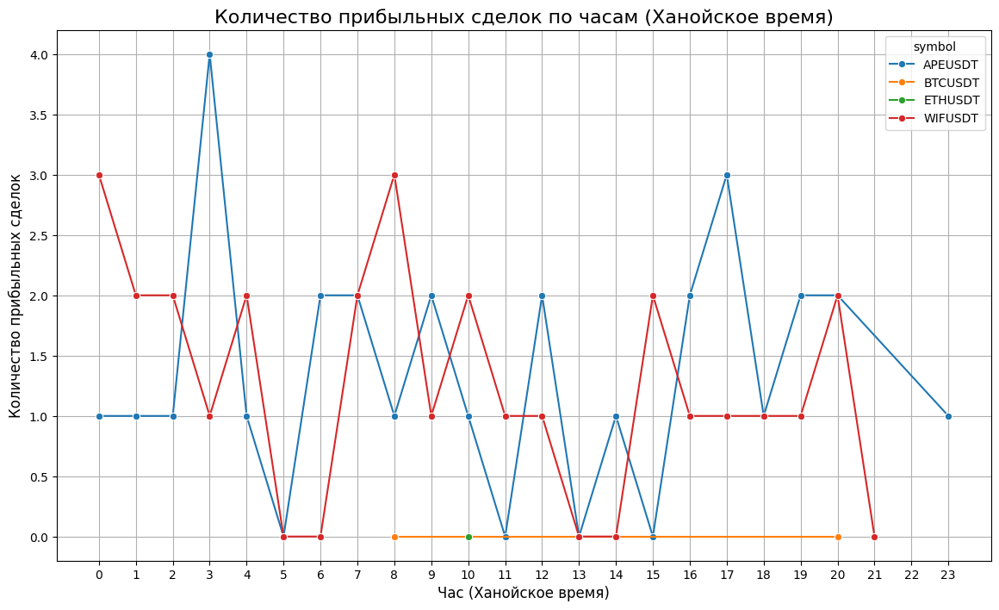

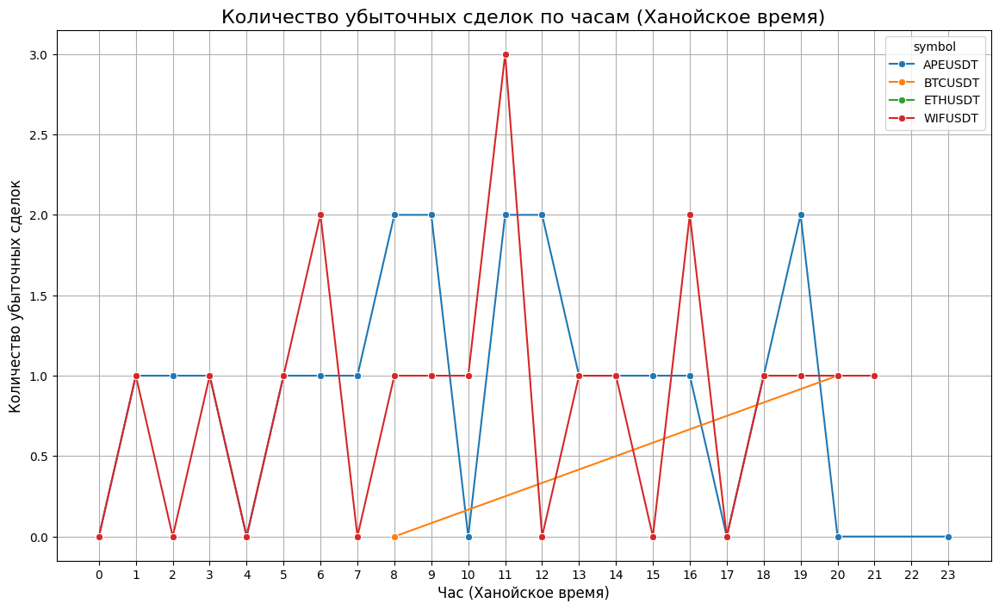

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Настраиваем размер графика
plt.figure(figsize=(14, 8))

# Создаем график прибыльных сделок по часам
sns.lineplot(
    data=grouped_by_hour,
    x='hour_open_hanoi',
    y='positive_trades',
    hue='symbol',
    marker='o',
    palette='tab10'
)
plt.title('Количество прибыльных сделок по часам (Ханойское время)', fontsize=16)
plt.xlabel('Час (Ханойское время)', fontsize=12)
plt.ylabel('Количество прибыльных сделок', fontsize=12)
plt.xticks(range(0, 24))  # Метки для каждого часа
plt.grid(True)

# Отображаем график
plt.show()

# Теперь аналогичный график для убыточных сделок
plt.figure(figsize=(14, 8))
sns.lineplot(
    data=grouped_by_hour,
    x='hour_open_hanoi',
    y='negative_trades',
    hue='symbol',
    marker='o',
    palette='tab10'
)
plt.title('Количество убыточных сделок по часам (Ханойское время)', fontsize=16)
plt.xlabel('Час (Ханойское время)', fontsize=12)
plt.ylabel('Количество убыточных сделок', fontsize=12)
plt.xticks(range(0, 24))
plt.grid(True)

# Отображаем график
plt.show()


# Draft

In [ ]:
# Преобразуем время открытия и закрытия в datetime формат
df['open_time'] = pd.to_datetime(df['open_time'], unit='ms')
df['close_time'] = pd.to_datetime(df['close_time'], unit='ms')

# Вычисляем продолжительность сделки в минутах
df['trade_duration'] = (df['close_time'] - df['open_time']).dt.total_seconds() / 60

# Фильтрация закрытых сделок
closed_trades = df[df['status'] == 'CLOSED']

# Разделение на положительные и отрицательные сделки
positive_trades = closed_trades[closed_trades['result'] > 0]
negative_trades = closed_trades[closed_trades['result'] < 0]

# Анализ по каждой монете с подсчётом сделок, прибыли и убытков
coin_analysis = closed_trades.groupby('symbol').agg(
    total_trades=('id', 'count'),
    positive_trades=('result', lambda x: (x > 0).sum()),
    negative_trades=('result', lambda x: (x < 0).sum()),
    profit=('result', lambda x: x[x > 0].sum()),
    loss=('result', lambda x: x[x < 0].sum()),
    # Calculate total_profit using a lambda function that references the 'result' column directly
    total_profit=('result', lambda x: x[x > 0].sum() + x[x < 0].sum()),
    avg_trade_duration_min=('trade_duration', 'mean')
).reset_index()

# Сортировка по количеству сделок
coin_analysis = coin_analysis.sort_values(by='total_trades', ascending=False)

# Вывод результатов
print("Анализ по монетам (отсортирован по количеству сделок):")
display(coin_analysis)
print()
print(f"Всего положительных сделок: {len(positive_trades)}")
print(f"Всего отрицательных сделок: {len(negative_trades)}")


Анализ по монетам (отсортирован по количеству сделок):


,symbol,total_trades,positive_trades,negative_trades,profit,loss,total_profit,avg_trade_duration_min
0,APEUSDT,31,18,13,0.82960,-0.82080,0.00880,6.691500
1,WIFUSDT,30,19,11,0.71609,-0.47311,0.24298,5.407267



Всего положительных сделок: 37
Всего отрицательных сделок: 24


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import pytz
from matplotlib.dates import DateFormatter
import os

In [ ]:
# Локализуем время в UTC, а затем конвертируем в часовой пояс Ханоя
df['open_time'] = pd.to_datetime(df['open_time'], unit='ms')  # Конвертация в datetime формат
df['close_time'] = pd.to_datetime(df['close_time'], unit='ms')  # Конвертация в datetime формат

# Локализация времени в UTC (если данные изначально в UTC)
df['open_time'] = df['open_time'].dt.tz_localize('UTC')
df['close_time'] = df['close_time'].dt.tz_localize('UTC')

# Конвертация времени в таймзону Ханоя (UTC+7)
hanoi_tz = pytz.timezone('Asia/Ho_Chi_Minh')
df['open_time_hanoi'] = df['open_time'].dt.tz_convert(hanoi_tz)
df['close_time_hanoi'] = df['close_time'].dt.tz_convert(hanoi_tz)

# Продолжение анализа и построения графиков


TypeError: '<=' not supported between instances of 'Timedelta' and 'int'

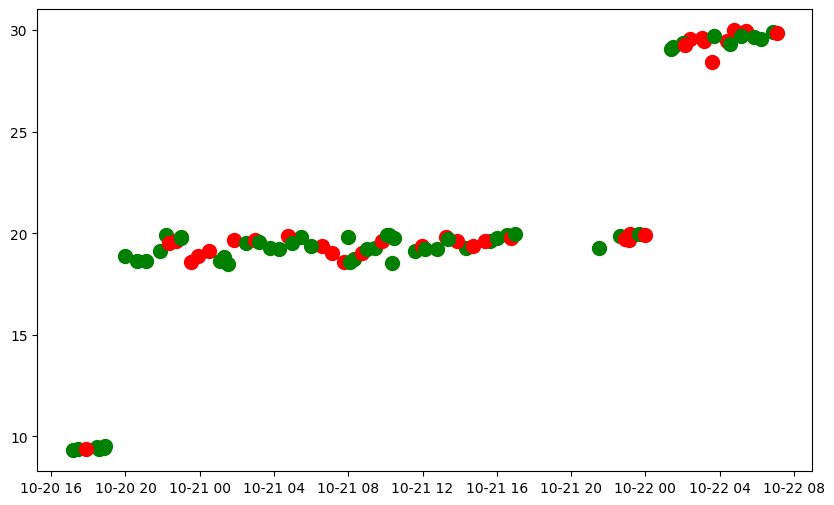

In [ ]:
import pandas as pd
import pytz
import matplotlib.pyplot as plt

# Загружаем данные из CSV
df = pd.read_csv('trades_data_3.csv')

# Конвертируем временные данные в формат datetime с учетом миллисекунд
df['open_time'] = pd.to_datetime(df['open_time'], unit='ms', utc=True)
df['close_time'] = pd.to_datetime(df['close_time'], unit='ms', utc=True)

# Конвертируем время в таймзону Ханоя
hanoi_tz = pytz.timezone('Asia/Ho_Chi_Minh')
df['open_time_hanoi'] = df['open_time'].dt.tz_convert(hanoi_tz)

# Группируем данные по каждой монете
grouped = df.groupby('symbol')

# Строим график для каждой монеты
for symbol, group in grouped:
    fig, ax = plt.subplots(figsize=(10, 6))

    # Убираем синюю линию, строим только точки сделок
    for i, row in group.iterrows():
        color = 'green' if row['result'] > 0 else 'red'
        ax.scatter(row['open_time_hanoi'], row['order_size'], color=color, s=100)

    # Устанавливаем шаг по оси X в 30 минут
    ax.xaxis.set_major_locator(plt.MultipleLocator(pd.Timedelta(minutes=30)))
    ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: pd.to_datetime(x).strftime('%H:%M')))

    # Подробная шкала времени
    ax.set_xlabel('Время (Ханой)', fontsize=12)
    ax.set_ylabel('Размер сделки', fontsize=12)
    ax.set_title(f'Сделки по монете: {symbol}', fontsize=14)
    ax.grid(True)

    # Убираем легенду для чистоты графика
    ax.get_legend().remove()

    # Улучшаем отображение временной оси
    fig.autofmt_xdate()

    plt.show()



